## Question1. Train a DDPM on the butterfly dataset. Plot the U-Net training loss curves

We will be using diffusers library available in hugging face and their tutorial on training a DDPM on custom dataset. We will be using the butterfly dataset for this task. We will be using the U-Net architecture for the model. We will be plotting the training loss curves for the U-Net model.

### Defining Hyperparameters

In [ ]:
from dataclasses import dataclass

@dataclass
class TrainingConfig:
    image_size = 128  # the generated image resolution
    train_batch_size = 16
    eval_batch_size = 16  # how many images to sample during evaluation
    num_epochs = 50
    gradient_accumulation_steps = 1
    learning_rate = 1e-4
    lr_warmup_steps = 500
    save_image_epochs = 5
    save_model_epochs = 10
    mixed_precision = 'fp16'  # `no` for float32, `fp16` for automatic mixed precision
    output_dir = 'LatentOutput'  # the model namy locally and on the HF Hub

    push_to_hub = False  # whether to upload the saved model to the HF Hub
    hub_private_repo = False  
    overwrite_output_dir = True  # overwrite the old model when re-running the notebook
    seed = 0

config = TrainingConfig()

In [ ]:
# Transformations with small augmentations

import os
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
from PIL import Image

# Define the image transformations
transform = transforms.Compose([
    transforms.Resize((128, 128)),  # Resize to 128x128 (adjust as needed)
    transforms.RandomHorizontalFlip(),  # Randomly flip the image horizontally
    transforms.ToTensor(),  # Convert the image to a tensor
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])  # Normalize with mean and std
])

# Load the anime images from the 'anime' folder
anime_folder = 'Butterfly'  # Path to your anime images folder
dataset = datasets.ImageFolder(root=anime_folder, transform=transform)

In [ ]:
# Making PyTorch Dataloaders
import torch
trainLoader = torch.utils.data.DataLoader(dataset, batch_size=16, shuffle=True)

In [ ]:
# PLot a batch of images
import matplotlib.pyplot as plt
import numpy as np

# Assuming trainLoader is your DataLoader with images
for i in trainLoader:
    np_images = i[0].numpy()

    # Unnormalize the images back to the range [0, 1]
    np_images = np.clip(np_images * 0.5 + 0.5, 0, 1)  # Reverse the normalization: (x * std + mean)

    # Plot the images
    fig, axes = plt.subplots(4, 4, figsize=(10, 10))
    for i, ax in enumerate(axes.flat):
        ax.imshow(np.transpose(np_images[i], (1, 2, 0)))  # Convert from CHW to HWC format
        ax.axis('off')
        
    plt.show()
    break

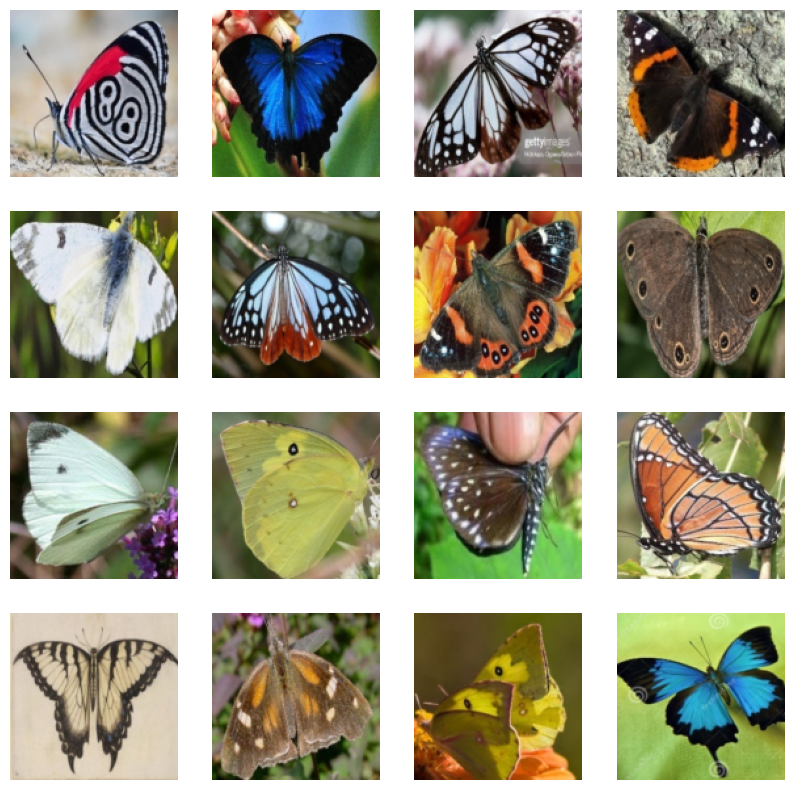

In [21]:
from IPython.display import Image
from IPython.display import display

display(Image(filename='Images/original.png'))

In [ ]:
# Defining the U Net model from the diffusers library
from diffusers import UNet2DModel

model = UNet2DModel(
    sample_size=128,  # the target image resolution
    in_channels=3,  # the number of input channels, 3 for RGB images
    out_channels=3,  # the number of output channels
    layers_per_block=2,  # how many ResNet layers to use per UNet block
    block_out_channels=(128, 128, 256, 256, 512, 512),  # the number of output channes for each UNet block
    down_block_types=( 
        "DownBlock2D",  # a regular ResNet downsampling block
        "DownBlock2D", 
        "DownBlock2D", 
        "DownBlock2D", 
        "AttnDownBlock2D",  # a ResNet downsampling block with spatial self-attention
        "DownBlock2D",
    ), 
    up_block_types=(
        "UpBlock2D",  # a regular ResNet upsampling block
        "AttnUpBlock2D",  # a ResNet upsampling block with spatial self-attention
        "UpBlock2D", 
        "UpBlock2D", 
        "UpBlock2D", 
        "UpBlock2D"  
      ),
)

In [ ]:
# Passing a sample image through model to check the output shape is correct or not

sampleImage = dataset[0][0].unsqueeze(0)
print("Input shape:", sampleImage.shape)

print("Output shape:", model(sampleImage,timestep=0).sample.shape)

In [ ]:
# Using DDPM scheduler from diffusers library, (alpha_t's will be calculated and handled by this scheduler)

from diffusers import DDPMScheduler
noise_scheduler = DDPMScheduler(num_train_timesteps=1000)

In [ ]:
# Sampling a random time step and adding noise to the image corresponding to that time step

import torch 
from PIL import Image  

noise = torch.randn(sampleImage.shape)
timesteps = torch.LongTensor([50])

noisyImage = noise_scheduler.add_noise(sampleImage, noise, timesteps)

Image.fromarray(((noisyImage.permute(0,2,3,1) + 1.0)*127.5).type(torch.uint8).numpy()[0])

In [ ]:
# Predicting noise for the above noisy image according to algorithm explained in Original DDPM Paper

import torch.nn.functional as F 

noisePred = model(noisyImage, timesteps).sample 
loss = F.mse_loss(noisePred, sampleImage)

print("Loss:", loss.item())

In [ ]:
# Using AdamW optimizer from torch.optim

optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4)

from diffusers.optimization import get_cosine_schedule_with_warmup
num_epochs = 50

learningRateScheduler = get_cosine_schedule_with_warmup(
    optimizer = optimizer,
    num_warmup_steps = 500,
    num_training_steps = len(trainLoader)*num_epochs,
)

In [ ]:
# Make grid function to display images and evaluate function to sample images after every k training epochs which can be modified in 
# first code block in config file


from diffusers import DDPMPipeline

import math

def make_grid(images, rows, cols):
    w, h = images[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, image in enumerate(images):
        grid.paste(image, box=(i%cols*w, i//cols*h))
    return grid

def evaluate(config, epoch, pipeline):
    # Sample some images from random noise (this is the backward diffusion process).
    # The default pipeline output type is `List[PIL.Image]`
    images = pipeline(
        batch_size = config.eval_batch_size, 
        generator=torch.manual_seed(config.seed),
    ).images

    # Make a grid out of the images
    image_grid = make_grid(images, rows=4, cols=4)

    # Save the images
    test_dir = os.path.join(config.output_dir, "samples")
    os.makedirs(test_dir, exist_ok=True)
    image_grid.save(f"{test_dir}/{epoch:04d}.png")

In [ ]:
# importing other required libraries.

from accelerate import Accelerator
from huggingface_hub import HfFolder, Repository, whoami

from tqdm.auto import tqdm
from pathlib import Path
import os
import json

In [ ]:
# This function can be used to push to huggingface hub if push_to_hub is set to True in config file and given the required credentials.
def get_full_repo_name(model_id: str, organization: str = None, token: str = None):
    if token is None:
        token = HfFolder.get_token()
    if organization is None:
        username = whoami(token)["name"]
        return f"{username}/{model_id}"
    else:
        return f"{organization}/{model_id}"

# This is main training loop which will train the model and save the model and images after every k epochs as defined in config file.
def train_loop(config, model, noise_scheduler, optimizer, train_dataloader, lr_scheduler):
    # Initialize accelerator and tensorboard logging (Accelerator library has really made the training and sampling faster and easier)
    accelerator = Accelerator(
        mixed_precision=config.mixed_precision,
        gradient_accumulation_steps=config.gradient_accumulation_steps, 
        log_with="tensorboard",
        project_dir=os.path.join(config.output_dir, "logs")
    )
    if accelerator.is_main_process:
        if config.push_to_hub:
            repo_name = get_full_repo_name(Path(config.output_dir).name)
            repo = Repository(config.output_dir, clone_from=repo_name)
        elif config.output_dir is not None:
            os.makedirs(config.output_dir, exist_ok=True)
        accelerator.init_trackers("train_example")
    
    # Prepare everything
    model, optimizer, train_dataloader, lr_scheduler = accelerator.prepare(
        model, optimizer, train_dataloader, lr_scheduler
    )
    
    global_step = 0
    epoch_losses = []  # List to store loss values for each epoch

    for epoch in range(config.num_epochs):
        epoch_loss = 0.0  # To accumulate loss for the epoch
        progress_bar = tqdm(total=len(train_dataloader), disable=not accelerator.is_local_main_process)
        progress_bar.set_description(f"Epoch {epoch}")

        for step, batch in enumerate(train_dataloader):
            clean_images = batch[0]
            # Sample noise to add to the images
            noise = torch.randn(clean_images.shape).to(clean_images.device)
            bs = clean_images.shape[0]

            # Sample a random timestep for each image
            timesteps = torch.randint(0, noise_scheduler.num_train_timesteps, (bs,), device=clean_images.device).long()

            # Add noise to the clean images
            noisy_images = noise_scheduler.add_noise(clean_images, noise, timesteps)
            
            with accelerator.accumulate(model):
                # Predict the noise residual
                noise_pred = model(noisy_images, timesteps, return_dict=False)[0]
                loss = F.mse_loss(noise_pred, noise)
                accelerator.backward(loss)

                accelerator.clip_grad_norm_(model.parameters(), 1.0)
                optimizer.step()
                lr_scheduler.step()
                optimizer.zero_grad()
            
            progress_bar.update(1)
            logs = {"loss": loss.detach().item(), "lr": lr_scheduler.get_last_lr()[0], "step": global_step}
            progress_bar.set_postfix(**logs)
            accelerator.log(logs, step=global_step)
            global_step += 1

            epoch_loss += loss.item()  # Accumulate loss for the epoch

        # Average loss for the epoch
        epoch_loss /= len(train_dataloader)
        epoch_losses.append(epoch_loss)  # Save epoch loss
        print(f"Epoch {epoch}: Average Loss = {epoch_loss:.4f}")

        # Save demo images and model
        if accelerator.is_main_process:
            pipeline = DDPMPipeline(unet=accelerator.unwrap_model(model), scheduler=noise_scheduler)

            if (epoch + 1) % config.save_image_epochs == 0 or epoch == config.num_epochs - 1:
                evaluate(config, epoch, pipeline)

            if (epoch + 1) % config.save_model_epochs == 0 or epoch == config.num_epochs - 1:
                if config.push_to_hub:
                    repo.push_to_hub(commit_message=f"Epoch {epoch}", blocking=True)
                else:
                    pipeline.save_pretrained(config.output_dir)
    
    # Save losses to a file for plotting later
    if accelerator.is_main_process:
        with open(os.path.join(config.output_dir, "losses.json"), "w") as f:
            json.dump(epoch_losses, f)

In [ ]:
# Running this cell will start the DDPM training loop

from accelerate import notebook_launcher
args = (config, model, noise_scheduler, optimizer, trainLoader, learningRateScheduler)

notebook_launcher(train_loop, args, num_processes=1)

In [ ]:
# Sample 100 images and plot them
pipeline = DDPMPipeline(unet=model, scheduler=noise_scheduler)
images = pipeline(batch_size=100).images

image_grid = make_grid(images, rows=10, cols=10)
image_grid.save("final_samples.png")


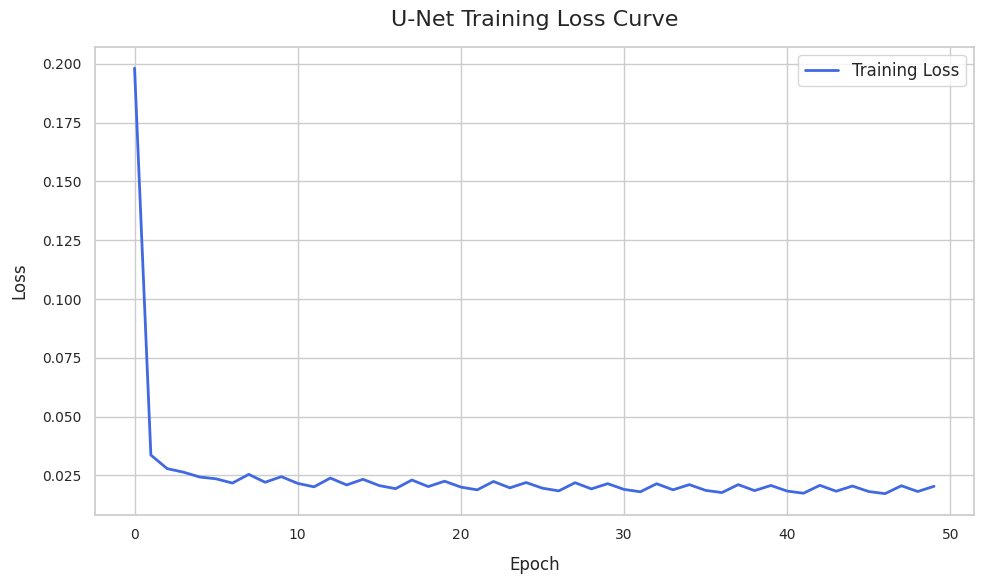

In [3]:
# Here is the loss curve for U net model trained on Butterfly dataset using DDPM algorithm
# We trained for 50 epochs only because DDPM takes a lot of time to train and we have limited resources.

# Curve 1 which shows training loss for each epoch 1-50
display(Image(filename='Images/loss1.png'))

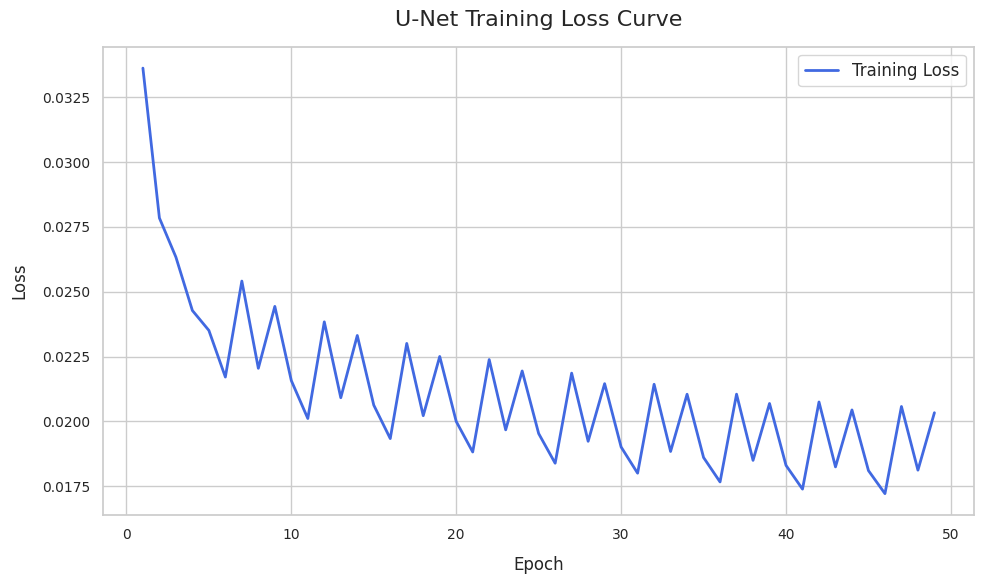

In [4]:
# This curve shows the training loss for each epoch 2-50
display(Image(filename='Images/loss2.png'))

# Question 2

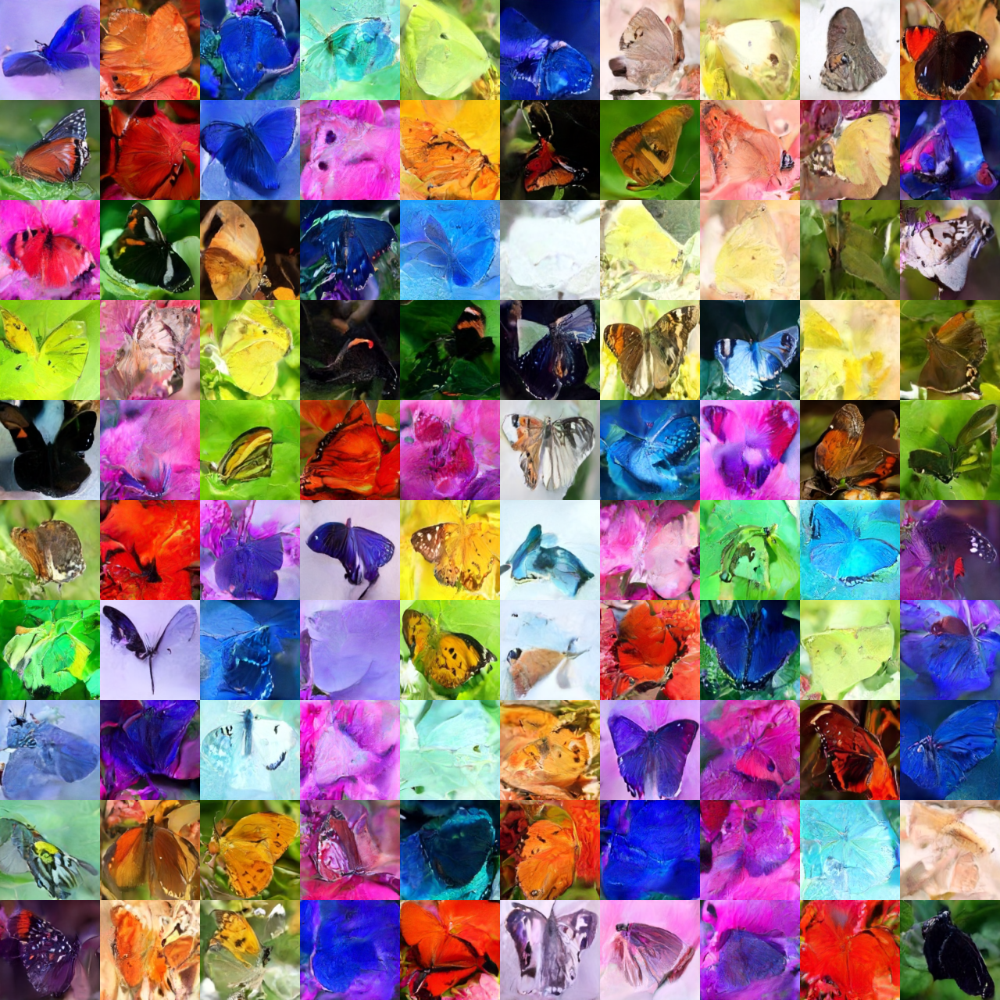

In [ ]:
# Here are the final 100 images generated by the model after training for 50 epochs, due to limited compute available we trained for only 50 epochs.
display(Image(filename='Images/final_samples.png'))

## Question 3: Computing FID 
Again we will use our code from last 2 assignments and PyTorch builtin functions to calculate FID score for the generated images.
Here are the results for the FID score for the generated images.

1. FID score for the generated images using our code from last 2 assignments:  145
2. FID score for the generated images using PyTorch builtin functions:  148

I dont know why so clear images have such high FID score. This happened previously also. I will try to find the reason for this.

# Question 4:Repeat the above experiments by training the DDPM on the latent space of the VQ-VAE trained in the previous assignment

In [ ]:
# Last time we trained VQ VAE on Butterfly dataset with Latent space dimensions = 128*16*16, For this Assignment we trained it again
# but this time with Latent space dimensions = 3*16*16 and for 50 epochs. Here is the implementation of VQ VAE first

import torch
import warnings 
warnings.filterwarnings('ignore')
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, TensorDataset
from torchvision import transforms
from PIL import Image
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report
import os
from tqdm import tqdm
from sklearn.preprocessing import StandardScaler
import matplotlib as plt
#import GradScale:
from torch.cuda.amp import GradScaler, autocast
from matplotlib import pyplot as plt  # or import matplotlib.pyplot as plt

class ButterflyDataset(Dataset):
    def __init__(self, csv_file, img_dir, transform=None):
        self.data = pd.read_csv(csv_file)
        self.img_dir = img_dir
        self.transform = transform
        self.labels = {label: idx for idx, label in enumerate(self.data['label'].unique())}
        
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        img_name = os.path.join(self.img_dir, self.data.iloc[idx, 0])
        image = Image.open(img_name).convert('RGB')
        if self.transform:
            image = self.transform(image)
        label = self.labels[self.data.iloc[idx, 1]]
        return image, label
 
# [VQ-VAE Components - VectorQuantizer, Encoder, Decoder, and VQVAE classes remain the same]
class VectorQuantizer(nn.Module):
    def __init__(self, num_embeddings, embedding_dim, commitment_cost=0.25):
        super().__init__()
        self.embedding_dim = embedding_dim
        self.num_embeddings = num_embeddings
        self.commitment_cost = commitment_cost
        
        self.embeddings = nn.Embedding(num_embeddings, embedding_dim)
        self.embeddings.weight.data.uniform_(-1/num_embeddings, 1/num_embeddings)
 
    def forward(self, inputs):
        inputs = inputs.permute(0, 2, 3, 1).contiguous()
        input_shape = inputs.shape
        
        flat_input = inputs.view(-1, self.embedding_dim)
        
        distances = (torch.sum(flat_input**2, dim=1, keepdim=True)
                    + torch.sum(self.embeddings.weight**2, dim=1)
                    - 2 * torch.matmul(flat_input, self.embeddings.weight.t()))
        
        encoding_indices = torch.argmin(distances, dim=1).unsqueeze(1)
        encodings = torch.zeros(encoding_indices.shape[0], self.num_embeddings, device=inputs.device)
        encodings.scatter_(1, encoding_indices, 1)
        
        quantized = torch.matmul(encodings, self.embeddings.weight).view(input_shape)
        
        e_latent_loss = torch.mean((quantized.detach() - inputs)**2)
        q_latent_loss = torch.mean((quantized - inputs.detach())**2)
        loss = q_latent_loss + self.commitment_cost * e_latent_loss
        
        quantized = inputs + (quantized - inputs).detach()
        avg_probs = torch.mean(encodings, dim=0)
        perplexity = torch.exp(-torch.sum(avg_probs * torch.log(avg_probs + 1e-10)))
        
        return quantized.permute(0, 3, 1, 2).contiguous(), loss, encoding_indices.view(input_shape[:-1])
 
class ResidualBlock(nn.Module):
    def __init__(self, channels):
        super().__init__()
        self.block = nn.Sequential(
            nn.BatchNorm2d(channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(channels, channels, 3, padding=1),
            nn.BatchNorm2d(channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(channels, channels, 1)
        )
 
    def forward(self, x):
        return x + self.block(x)
 
class ImprovedEncoder(nn.Module):
    def __init__(self, in_channels, hidden_channels, num_residual_layers, embedding_dim):
        super().__init__()
        self.conv_layers = nn.Sequential(
            nn.Conv2d(in_channels, hidden_channels, 4, stride=2, padding=1),
            nn.BatchNorm2d(hidden_channels),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(hidden_channels, hidden_channels * 2, 4, stride=2, padding=1),
            nn.BatchNorm2d(hidden_channels * 2),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(hidden_channels * 2, hidden_channels * 4, 4, stride=2, padding=1),
            nn.BatchNorm2d(hidden_channels * 4),
            nn.ReLU(inplace=True)
        )
        
        self.residual_stack = nn.ModuleList([
            ResidualBlock(hidden_channels * 4) for _ in range(num_residual_layers)
        ])
        
        self.final_conv = nn.Conv2d(hidden_channels * 4, embedding_dim, 3, padding=1)
        
    def forward(self, x):
        h = self.conv_layers(x)
        for residual in self.residual_stack:
            h = residual(h)
        return self.final_conv(h)
 
class ImprovedDecoder(nn.Module):
    def __init__(self, in_channels, hidden_channels, num_residual_layers):
        super().__init__()
        self.conv_1 = nn.Conv2d(in_channels, hidden_channels * 4, 3, padding=1)
        
        self.residual_stack = nn.ModuleList([
            ResidualBlock(hidden_channels * 4) for _ in range(num_residual_layers)
        ])
        
        self.deconv_layers = nn.Sequential(
            nn.ConvTranspose2d(hidden_channels * 4, hidden_channels * 2, 4, stride=2, padding=1),
            nn.BatchNorm2d(hidden_channels * 2),
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(hidden_channels * 2, hidden_channels, 4, stride=2, padding=1),
            nn.BatchNorm2d(hidden_channels),
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(hidden_channels, 3, 4, stride=2, padding=1),
            nn.Tanh()
        )
        
    def forward(self, x):
        h = self.conv_1(x)
        for residual in self.residual_stack:
            h = residual(h)
        return self.deconv_layers(h)
 
class ImprovedVQVAE(nn.Module):
    def __init__(self, num_embeddings, embedding_dim, hidden_channels, num_residual_layers):
        super().__init__()
        self.encoder = ImprovedEncoder(3, hidden_channels, num_residual_layers, embedding_dim)
        self.vector_quantizer = VectorQuantizer(num_embeddings, embedding_dim, commitment_cost=0.5)
        self.decoder = ImprovedDecoder(embedding_dim, hidden_channels, num_residual_layers)
        
    def encode(self, x):
        """
        Encodes the input and returns the encoding indices from the vector quantizer
        
        Args:
            x (torch.Tensor): Input tensor of shape [B, C, H, W]
            
        Returns:
            torch.Tensor: Encoding indices
        """
        z = self.encoder(x)
        _, _, encoding_indices = self.vector_quantizer(z)
        return encoding_indices
    
    def forward(self, x):
        z = self.encoder(x)
        z_q, loss, encoding_indices = self.vector_quantizer(z)
        x_recon = self.decoder(z_q)
        return x_recon, loss, encoding_indices
 
class ImprovedAdvancedLatentClassifier(nn.Module):
    def __init__(self, input_size, hidden_size, num_classes, dropout_rate=0.5):
        super().__init__()
        
        self.network = nn.Sequential(
            nn.Linear(input_size, hidden_size),
            nn.LayerNorm(hidden_size),
            nn.GELU(),
            nn.Dropout(dropout_rate),
            
            nn.Linear(hidden_size, hidden_size),
            nn.LayerNorm(hidden_size),
            nn.GELU(),
            nn.Dropout(dropout_rate),
            
            nn.Linear(hidden_size, hidden_size),
            nn.LayerNorm(hidden_size),
            nn.GELU(),
            nn.Dropout(dropout_rate),
            
            nn.Linear(hidden_size, hidden_size // 2),
            nn.LayerNorm(hidden_size // 2),
            nn.GELU(),
            nn.Dropout(dropout_rate),
            
            nn.Linear(hidden_size // 2, hidden_size // 4),
            nn.LayerNorm(hidden_size // 4),
            nn.GELU(),
            nn.Dropout(dropout_rate),
            
            nn.Linear(hidden_size // 4, num_classes)
        )
        
        # Initialize weights using He initialization
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
                nn.init.constant_(m.bias, 0)
    
    def forward(self, x):
        return self.network(x)
    
from tqdm import tqdm

def train_improved_vqvae(model, train_loader, val_loader, num_epochs, device):
    optimizer = optim.AdamW(model.parameters(), lr=1e-3, weight_decay=1e-5)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=num_epochs)
    best_val_loss = float('inf')

    for epoch in range(num_epochs):
        model.train()
        train_loss = 0

        # Training Progress Bar
        train_bar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Training]", leave=False)
        for batch_idx, (data, _) in enumerate(train_bar):
            data = data.to(device)
            optimizer.zero_grad()

            recon_batch, vq_loss, _ = model(data)
            recon_loss = nn.MSELoss()(recon_batch, data)
            loss = recon_loss + vq_loss

            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()

            train_loss += loss.item()
            train_bar.set_postfix({
                "Batch Loss": f"{loss.item():.4f}",
                "Avg Train Loss": f"{train_loss / (batch_idx + 1):.4f}"
            })

        scheduler.step()

        # Validation
        model.eval()
        val_loss = 0
        val_bar = tqdm(val_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Validation]", leave=False)
        with torch.no_grad():
            for batch_idx, (data, _) in enumerate(val_bar):
                data = data.to(device)
                recon_batch, vq_loss, _ = model(data)
                recon_loss = nn.MSELoss()(recon_batch, data)
                loss = recon_loss + vq_loss

                val_loss += loss.item()
                val_bar.set_postfix({
                    "Batch Loss": f"{loss.item():.4f}",
                    "Avg Val Loss": f"{val_loss / (batch_idx + 1):.4f}"
                })

        # Epoch Summary
        train_loss_avg = train_loss / len(train_loader)
        val_loss_avg = val_loss / len(val_loader)
        print(f"Epoch {epoch+1}/{num_epochs}: Train Loss: {train_loss_avg:.4f}, Val Loss: {val_loss_avg:.4f}")

        # Save the best model
        if val_loss_avg < best_val_loss:
            best_val_loss = val_loss_avg
            torch.save(model.state_dict(), 'best_vqvae.pth')
            print(f"Epoch {epoch+1}: New best model saved with Val Loss: {best_val_loss:.4f}")

# Function to extract latent vectors
def extract_latent_vectors(model, dataloader, device):
    model.eval()
    all_latents = []
    all_labels = []
    
    with torch.no_grad():
        for data, labels in tqdm(dataloader, desc="Extracting latent vectors"):
            data = data.to(device)
            encoding_indices = model.encode(data)
            all_latents.append(encoding_indices.cpu().numpy())
            all_labels.append(labels.numpy())
    
    return np.concatenate(all_latents), np.concatenate(all_labels)


def save_reconstructions_plot(model, dataloader, device, num_images=10):
    """Plot original and reconstructed images side by side"""
    model.eval()
    plt.figure(figsize=(20, 4))
    
    with torch.no_grad():
        for data, _ in dataloader:
            data = data.to(device)
            recon, _, _ = model(data)
            
            # Denormalize images
            mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(device)
            std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(device)
            
            original = (data * std + mean).cpu()
            reconstructed = (recon * std + mean).cpu()
            
            # Plot first num_images
            for i in range(min(num_images, data.size(0))):
                plt.subplot(2, num_images, i + 1)
                plt.imshow(original[i].permute(1, 2, 0).clamp(0, 1))
                plt.axis('off')
                plt.title('Original')
                
                plt.subplot(2, num_images, i + 1 + num_images)
                plt.imshow(reconstructed[i].permute(1, 2, 0).clamp(0, 1))
                plt.axis('off')
                plt.title('Reconstructed')
            
            plt.tight_layout()
            plt.show()
            break

def save_model_and_latents(vqvae, train_latents, val_latents, test_latents, 
                          train_labels, val_labels, test_labels):
    """Save model and latent vectors"""
    os.makedirs('model_latents_raina_final', exist_ok=True)
    
    # Save VQVAE model
    torch.save({
        'model_state_dict': vqvae.state_dict(),
        'model_config': {
            'num_embeddings': vqvae.vector_quantizer.num_embeddings,
            'embedding_dim': vqvae.vector_quantizer.embedding_dim,
            'hidden_channels': vqvae.encoder.conv_layers[0].out_channels,
            'num_residual_layers': len(vqvae.encoder.residual_stack)
        }
    }, 'model_latents_raina_final/vqvae_model.pth')
    
    # Save latent vectors and labels
    np.savez('model_latents_raina_final/latent_vectors.npz',
             train_latents=train_latents,
             val_latents=val_latents,
             test_latents=test_latents,
             train_labels=train_labels,
             val_labels=val_labels,
             test_labels=test_labels)
    
    
from tqdm import tqdm
from torch.cuda.amp import autocast, GradScaler

def train_improved_classifier(model, train_loader, val_loader, num_epochs, device):
    criterion = nn.CrossEntropyLoss(label_smoothing=0.1)
    optimizer = optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.01, betas=(0.9, 0.999))
    scheduler = optim.lr_scheduler.OneCycleLR(optimizer, max_lr=0.01, 
                                              epochs=num_epochs, 
                                              steps_per_epoch=len(train_loader))
    scaler = GradScaler()
    
    best_val_acc = 0
    patience = 15
    patience_counter = 0
    
    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        correct = 0
        total = 0
        
        # Training Progress Bar
        train_bar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Training]", leave=False)
        for inputs, labels in train_bar:
            inputs, labels = inputs.to(device), labels.to(device)
            
            # Initialize mixup variables
            labels_a = labels
            labels_b = labels
            lam = 1.0
            
            # Apply mixup augmentation with 50% probability
            if np.random.random() > 0.5:
                inputs, labels_a, labels_b, lam = mixup(inputs, labels, alpha=0.2)
            
            # Normalize input features
            inputs = (inputs - inputs.mean(dim=1, keepdim=True)) / (inputs.std(dim=1, keepdim=True) + 1e-8)
            
            optimizer.zero_grad()
            
            # Use mixed precision training
            with autocast():
                outputs = model(inputs)
                if lam < 1.0:  # Only use mixup loss if mixup was applied
                    loss = lam * criterion(outputs, labels_a) + (1 - lam) * criterion(outputs, labels_b)
                else:
                    loss = criterion(outputs, labels)
            
            scaler.scale(loss).backward()
            scaler.unscale_(optimizer)
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            scaler.step(optimizer)
            scaler.update()
            
            scheduler.step()
            
            train_loss += loss.item()
            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()

            # Update the progress bar
            train_bar.set_postfix({
                "Batch Loss": f"{loss.item():.4f}",
                "Avg Train Loss": f"{train_loss / (train_bar.n + 1):.4f}",
                "Train Acc": f"{100. * correct / total:.2f}%"
            })
        
        train_acc = 100. * correct / total
        
        # Validation Progress Bar
        model.eval()
        val_correct = 0
        val_total = 0
        val_loss = 0
        
        val_bar = tqdm(val_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Validation]", leave=False)
        with torch.no_grad():
            for inputs, labels in val_bar:
                inputs, labels = inputs.to(device), labels.to(device)
                inputs = (inputs - inputs.mean(dim=1, keepdim=True)) / (inputs.std(dim=1, keepdim=True) + 1e-8)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                val_loss += loss.item()
                _, predicted = outputs.max(1)
                val_total += labels.size(0)
                val_correct += predicted.eq(labels).sum().item()

                # Update validation progress bar
                val_bar.set_postfix({
                    "Batch Loss": f"{loss.item():.4f}",
                    "Avg Val Loss": f"{val_loss / (val_bar.n + 1):.4f}",
                    "Val Acc": f"{100. * val_correct / val_total:.2f}%"
                })
        
        val_acc = 100. * val_correct / val_total
        
        # Epoch Summary
        print(f'Epoch {epoch+1}: Train Acc: {train_acc:.2f}%, Val Acc: {val_acc:.2f}%')
        
        # Save best model and check early stopping
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            patience_counter = 0
            torch.save(model.state_dict(), 'best_classifier.pth')
            print(f"Epoch {epoch+1}: New best model saved with Val Acc: {best_val_acc:.2f}%")
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"Early stopping triggered after {epoch + 1} epochs")
                break

def mixup(x, y, alpha=0.2):
    """Performs mixup on the input and target labels."""
    if alpha > 0:
        lam = np.random.beta(alpha, alpha)
    else:
        lam = 1

    batch_size = x.size()[0]
    index = torch.randperm(batch_size).to(x.device)

    mixed_x = lam * x + (1 - lam) * x[index, :]
    y_a, y_b = y, y[index]
    return mixed_x, y_a, y_b, lam


def main():
    # Set random seeds for reproducibility
    torch.manual_seed(42)
    np.random.seed(42)
    
    # Hyperparameters
    num_embeddings = 512  # Increased from 512
    embedding_dim = 3    # Increased from 128
    hidden_channels = 128  # Increased from 128
    num_residual_layers = 6  # Increased from 4
    batch_size = 64       # Increased from 32
    num_epochs_vqvae = 50  # Increased from 50
    num_epochs_classifier = 50  # Increased from 30
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")
    # Data preparation
    transform = transforms.Compose([
    transforms.Resize((128, 128)),  
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], 
                        std=[0.229, 0.224, 0.225])
])
    
    print("Loading dataset...")
    dataset = ButterflyDataset(
        csv_file='Training_set.csv',
        img_dir='../Butterfly/train',
        transform=transform
    )
    
    # Split dataset
    train_size = int(0.7 * len(dataset))
    val_size = int(0.15 * len(dataset))
    test_size = len(dataset) - train_size - val_size
    train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(
        dataset, [train_size, val_size, test_size]
    )
    
    print(f"Dataset splits - Train: {train_size}, Val: {val_size}, Test: {test_size}")
    
    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
    
    # Initialize and train VQ-VAE
    print("\nInitializing VQ-VAE...")
    vqvae = ImprovedVQVAE(num_embeddings, embedding_dim, hidden_channels, num_residual_layers).to(device)
    
    # Check if pretrained model exists
    # if os.path.exists('best_vqvae.pth'):
    #     print("Loading pretrained VQ-VAE model...")
    #     vqvae.load_state_dict(torch.load('best_vqvae.pth'))
    # else:
    print("Training VQ-VAE from scratch...")
    train_improved_vqvae(vqvae, train_loader, val_loader, num_epochs_vqvae, device)
    
    # Extract latent vectors
    print("\nExtracting latent vectors...")
    train_latents, train_labels = extract_latent_vectors(vqvae, train_loader, device)
    val_latents, val_labels = extract_latent_vectors(vqvae, val_loader, device)
    test_latents, test_labels = extract_latent_vectors(vqvae, test_loader, device)
    
    # Flatten latent vectors
# Normalize latent vectors before training
    train_latents_flat = train_latents.reshape(train_latents.shape[0], -1)
    val_latents_flat = val_latents.reshape(val_latents.shape[0], -1)
    test_latents_flat = test_latents.reshape(test_latents.shape[0], -1)
    
    # Standardize the features
    scaler = StandardScaler()
    train_latents_flat = scaler.fit_transform(train_latents_flat)
    val_latents_flat = scaler.transform(val_latents_flat)
    test_latents_flat = scaler.transform(test_latents_flat)
    
    # Use larger batch size for better batch normalization statistics
    batch_size = 64
    
    # Create dataloaders with the normalized data
    train_dataset_latent = TensorDataset(
        torch.FloatTensor(train_latents_flat),
        torch.LongTensor(train_labels)
    )
    val_dataset_latent = TensorDataset(
        torch.FloatTensor(val_latents_flat),
        torch.LongTensor(val_labels)
    )
    
    test_dataset_latent = TensorDataset(
        torch.FloatTensor(test_latents_flat),
        torch.LongTensor(test_labels)
    )
    num_classes = 75
    train_loader_latent = DataLoader(train_dataset_latent, 
                                   batch_size=batch_size, 
                                   shuffle=True,
                                   num_workers=4,
                                   pin_memory=True)
    val_loader_latent = DataLoader(val_dataset_latent, 
                                 batch_size=batch_size, 
                                 shuffle=False,
                                 num_workers=4,
                                 pin_memory=True)
    
    test_loader_latent = DataLoader(test_dataset_latent,
                                    batch_size= batch_size,
                                    shuffle=True,
                                   num_workers=4,
                                   pin_memory=True)
    # Initialize improved classifier
 

    save_model_and_latents(vqvae, train_latents, val_latents, test_latents,
                          train_labels, val_labels, test_labels)
    
    # Save reconstruction comparison plot
    save_reconstructions_plot(vqvae, test_loader, device)

if __name__ == "__main__":
    main()

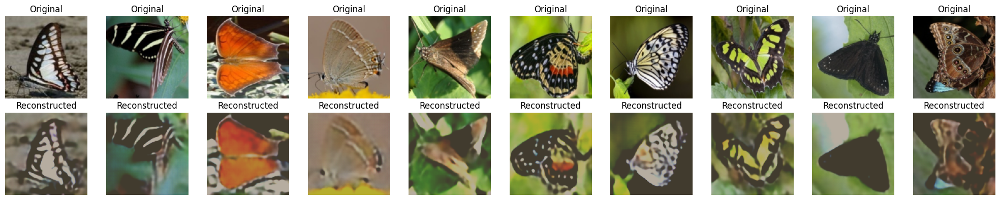

In [5]:
# Here are the reconstructed images by VQ VAE model with latent space dimensions = 3*16*16 after training for 50 epochs.
display(Image(filename='Images/vqrecons.png'))

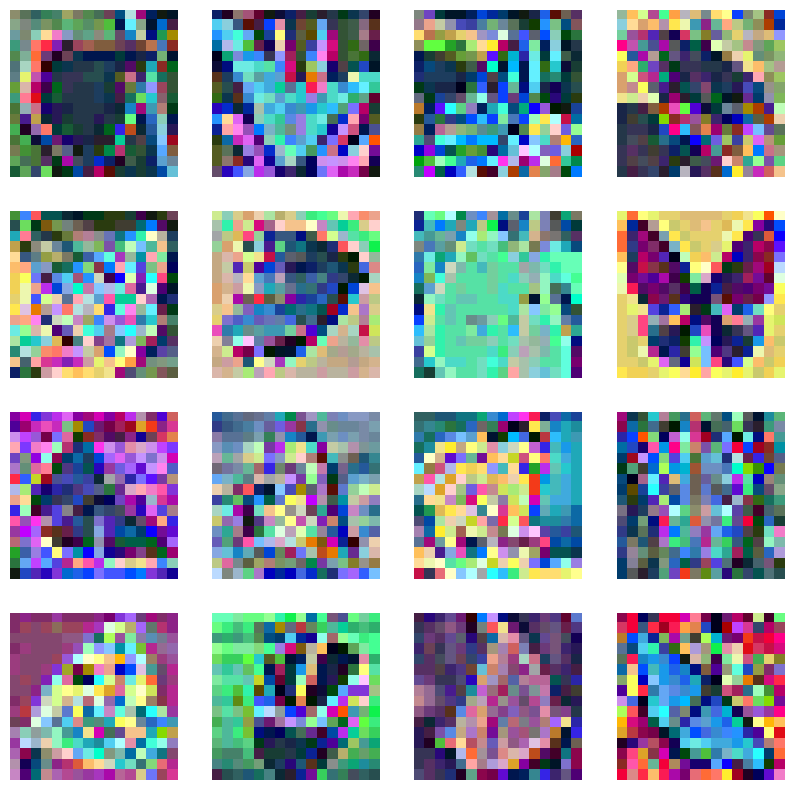

In [6]:
# We took 4529 training images and encoded them, then vector quantized them, saved them into a npz file 
# Then we has 3*16*16 latent space dimensions for each image, and we trained a DDPM model on these latent vectors for 50 epochs.

# Here is what these latents look like, since channels are 3, we can visualize them as RGB images.
display(Image(filename='Images/latents.png'))

In [ ]:
# We can see that these latents also look like butterfly images, but they are not as clear as the original images.
# Now we trained a DDPM model on these latent rgb images for 50 epochs using this implementation.
# This implementation is mostly same but changed at some places to make it work with latent space dimensions = 3*16*16.

from dataclasses import dataclass

@dataclass
class TrainingConfig:
    image_size = 16  # the generated latent resolution
    train_batch_size = 16
    eval_batch_size = 16  # how many images to sample during evaluation
    num_epochs = 10
    gradient_accumulation_steps = 1
    learning_rate = 1e-4
    lr_warmup_steps = 500
    save_image_epochs = 5
    save_model_epochs = 10
    mixed_precision = 'fp16'  # `no` for float32, `fp16` for automatic mixed precision
    output_dir = 'LatentOutput'  # the model namy locally and on the HF Hub

    push_to_hub = False  # whether to upload the saved model to the HF Hub
    hub_private_repo = False  
    overwrite_output_dir = True  # overwrite the old model when re-running the notebook
    seed = 0

config = TrainingConfig()


import os
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
from PIL import Image

# Define the image transformations
transform = transforms.Compose([
    transforms.ToTensor(),  # Convert the image to a tensor
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])  # Normalize with mean and std
])

# Load the anime images from the 'anime' folder
anime_folder = 'Latents'  # Path to your anime images folder
dataset = datasets.ImageFolder(root=anime_folder, transform=transform)

# PLot a batch of images
import torch

trainLoader = torch.utils.data.DataLoader(dataset, batch_size=16, shuffle=True)

import matplotlib.pyplot as plt
import numpy as np

# Assuming trainLoader is your DataLoader with images
for i in trainLoader:
    np_images = i[0].numpy()

    # Unnormalize the images back to the range [0, 1]
    np_images = np.clip(np_images * 0.5 + 0.5, 0, 1)  # Reverse the normalization: (x * std + mean)

    # Plot the images
    fig, axes = plt.subplots(4, 4, figsize=(10, 10))
    for i, ax in enumerate(axes.flat):
        ax.imshow(np.transpose(np_images[i], (1, 2, 0)))  # Convert from CHW to HWC format
        ax.axis('off')
        
    plt.show()
    break

# Above code will display latents

# This is modified Unet required for the task
from diffusers import UNet2DModel

model = UNet2DModel(
    sample_size=16,  # the target latent resolution
    in_channels=3,  # number of channels in latent space
    out_channels=3,  # number of channels in output (same as input)
    layers_per_block=2,  # ResNet layers per block
    block_out_channels=(64, 128, 128),  # Reduced channels for smaller inputs
    down_block_types=(
        "DownBlock2D",  # Downsampling block
        "DownBlock2D", 
        "AttnDownBlock2D",  # Attention block for global features
    ), 
    up_block_types=(
        "AttnUpBlock2D",  # Attention block for global features
        "UpBlock2D", 
        "UpBlock2D",  # Upsampling block
    ),
)

# Testing the model with first sample
sampleImage = dataset[0][0].unsqueeze(0)
print("Input shape:", sampleImage.shape)

print("Output shape:", model(sampleImage,timestep=0).sample.shape)

# Rest of the code remains same
from diffusers import DDPMScheduler

noise_scheduler = DDPMScheduler(num_train_timesteps=1000)

import torch 
from PIL import Image  

noise = torch.randn(sampleImage.shape)
timesteps = torch.LongTensor([50])

noisyImage = noise_scheduler.add_noise(sampleImage, noise, timesteps)

Image.fromarray(((noisyImage.permute(0,2,3,1) + 1.0)*127.5).type(torch.uint8).numpy()[0])

import torch.nn.functional as F 

noisePred = model(noisyImage, timesteps).sample 
loss = F.mse_loss(noisePred, sampleImage)

print("Loss:", loss.item())

optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4)

from diffusers.optimization import get_cosine_schedule_with_warmup

num_epochs = 50

learningRateScheduler = get_cosine_schedule_with_warmup(
    optimizer = optimizer,
    num_warmup_steps = 500,
    num_training_steps = len(trainLoader)*num_epochs,
)

from diffusers import DDPMPipeline

import math

def make_grid(images, rows, cols):
    w, h = images[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, image in enumerate(images):
        grid.paste(image, box=(i%cols*w, i//cols*h))
    return grid

def evaluate(config, epoch, pipeline):
    # Sample some images from random noise (this is the backward diffusion process).
    # The default pipeline output type is `List[PIL.Image]`
    images = pipeline(
        batch_size = config.eval_batch_size, 
        generator=torch.manual_seed(config.seed),
    ).images

    # Make a grid out of the images
    image_grid = make_grid(images, rows=4, cols=4)

    # Save the images
    test_dir = os.path.join(config.output_dir, "samples")
    os.makedirs(test_dir, exist_ok=True)
    image_grid.save(f"{test_dir}/{epoch:04d}.png")
    
from accelerate import Accelerator
from huggingface_hub import HfFolder, Repository, whoami

from tqdm.auto import tqdm
from pathlib import Path
import os
import json

def get_full_repo_name(model_id: str, organization: str = None, token: str = None):
    if token is None:
        token = HfFolder.get_token()
    if organization is None:
        username = whoami(token)["name"]
        return f"{username}/{model_id}"
    else:
        return f"{organization}/{model_id}"

def train_loop(config, model, noise_scheduler, optimizer, train_dataloader, lr_scheduler):
    # Initialize accelerator and tensorboard logging
    accelerator = Accelerator(
        mixed_precision=config.mixed_precision,
        gradient_accumulation_steps=config.gradient_accumulation_steps, 
        log_with="tensorboard",
        project_dir=os.path.join(config.output_dir, "logs")
    )
    if accelerator.is_main_process:
        if config.push_to_hub:
            repo_name = get_full_repo_name(Path(config.output_dir).name)
            repo = Repository(config.output_dir, clone_from=repo_name)
        elif config.output_dir is not None:
            os.makedirs(config.output_dir, exist_ok=True)
        accelerator.init_trackers("train_example")
    
    # Prepare everything
    model, optimizer, train_dataloader, lr_scheduler = accelerator.prepare(
        model, optimizer, train_dataloader, lr_scheduler
    )
    
    global_step = 0
    epoch_losses = []  # List to store loss values for each epoch

    for epoch in range(config.num_epochs):
        epoch_loss = 0.0  # To accumulate loss for the epoch
        progress_bar = tqdm(total=len(train_dataloader), disable=not accelerator.is_local_main_process)
        progress_bar.set_description(f"Epoch {epoch}")

        for step, batch in enumerate(train_dataloader):
            clean_images = batch[0]
            # Sample noise to add to the images
            noise = torch.randn(clean_images.shape).to(clean_images.device)
            bs = clean_images.shape[0]

            # Sample a random timestep for each image
            timesteps = torch.randint(0, noise_scheduler.num_train_timesteps, (bs,), device=clean_images.device).long()

            # Add noise to the clean images
            noisy_images = noise_scheduler.add_noise(clean_images, noise, timesteps)
            
            with accelerator.accumulate(model):
                # Predict the noise residual
                noise_pred = model(noisy_images, timesteps, return_dict=False)[0]
                loss = F.mse_loss(noise_pred, noise)
                accelerator.backward(loss)

                accelerator.clip_grad_norm_(model.parameters(), 1.0)
                optimizer.step()
                lr_scheduler.step()
                optimizer.zero_grad()
            
            progress_bar.update(1)
            logs = {"loss": loss.detach().item(), "lr": lr_scheduler.get_last_lr()[0], "step": global_step}
            progress_bar.set_postfix(**logs)
            accelerator.log(logs, step=global_step)
            global_step += 1

            epoch_loss += loss.item()  # Accumulate loss for the epoch

        # Average loss for the epoch
        epoch_loss /= len(train_dataloader)
        epoch_losses.append(epoch_loss)  # Save epoch loss
        print(f"Epoch {epoch}: Average Loss = {epoch_loss:.4f}")

        # Save demo images and model
        if accelerator.is_main_process:
            pipeline = DDPMPipeline(unet=accelerator.unwrap_model(model), scheduler=noise_scheduler)

            if (epoch + 1) % config.save_image_epochs == 0 or epoch == config.num_epochs - 1:
                evaluate(config, epoch, pipeline)

            if (epoch + 1) % config.save_model_epochs == 0 or epoch == config.num_epochs - 1:
                if config.push_to_hub:
                    repo.push_to_hub(commit_message=f"Epoch {epoch}", blocking=True)
                else:
                    pipeline.save_pretrained(config.output_dir)
    
    # Save losses to a file for plotting later
    if accelerator.is_main_process:
        with open(os.path.join(config.output_dir, "losses.json"), "w") as f:
            json.dump(epoch_losses, f)
            
from accelerate import notebook_launcher
args = (config, model, noise_scheduler, optimizer, trainLoader, learningRateScheduler)

notebook_launcher(train_loop, args, num_processes=1)

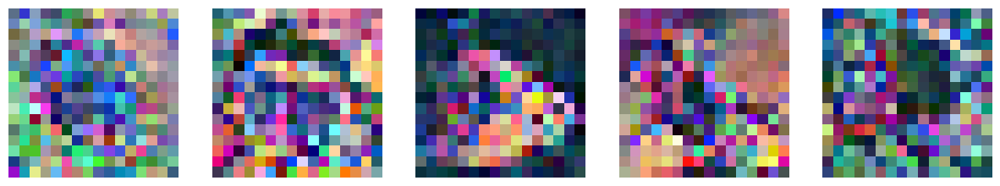

In [7]:
# Here are some of the generated Latent images after training the model for 50 epochs.
display(Image(filename='Images/latents2.png'))

In [8]:
# We can see in 50 epochs it was able to generate similar images but not as clear as the original images.
# We calculated FID between randomly choosen 1000 latents from training set and 1000 generated latents and here are results.

# 1. FID calculated using our implementation - 48.43
# 2. FID calculated using builtin pytorch implementation - 35.81 which shows that our implementation is working fine.

In [9]:
# But when we pass these generated latents into decoder, it was not able to generate clear images, how ever boundary
# of butterflies are visible in most of the cases

# Here are some of the generated images after passing generated latents into the decoder.

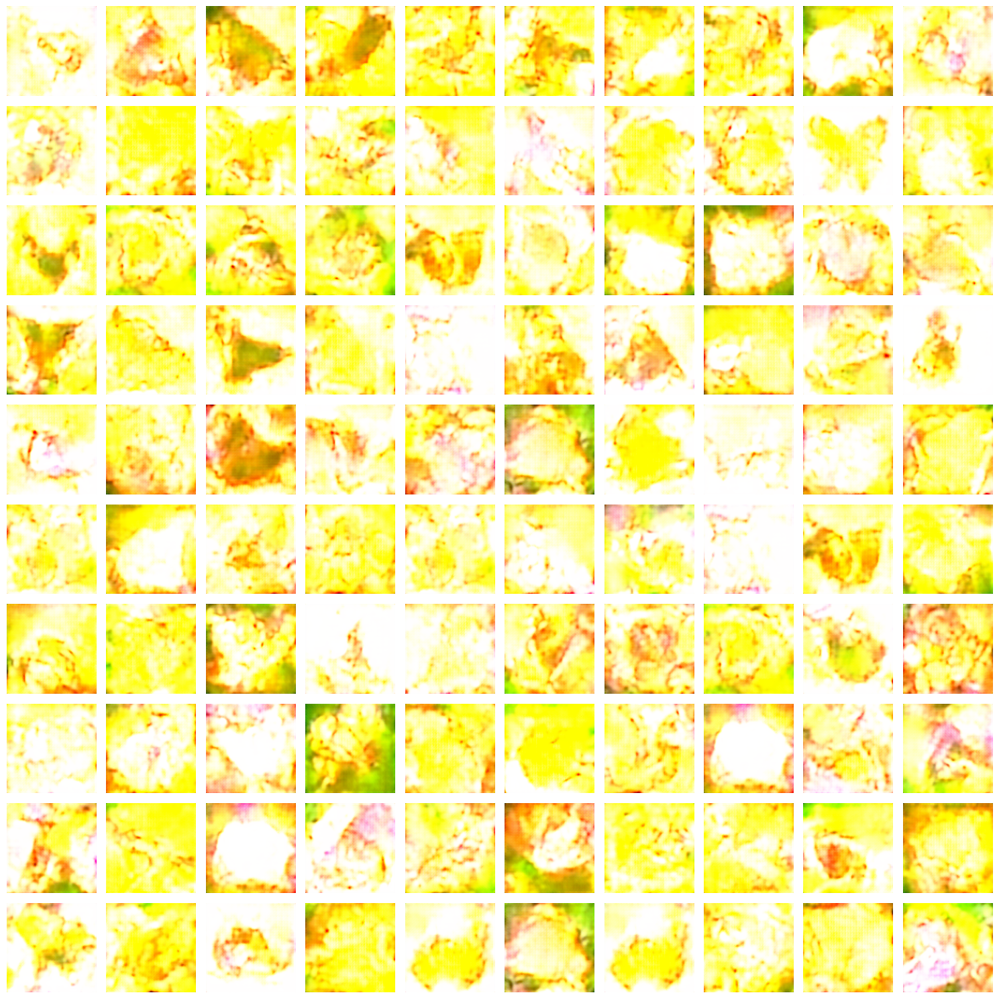

In [10]:
display(Image(filename='Images/vqrecons2.png'))

In [11]:
# We can see that boundary is clear but it was not able to reconstruct the images properly. But DDPM was able to generate 
# Good Quality Latents from the images.

# Question6: IMplementing a noise conditional score network

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
from tqdm import tqdm
import os
import numpy as np

# Set random seed for reproducibility
torch.manual_seed(42)

# Hyperparameters
BATCH_SIZE = 64
NUM_EPOCHS = 100
LEARNING_RATE = 0.0002  # Reduced learning rate
IMAGE_SIZE = 64
SIGMA_BEGIN = 1
SIGMA_END = 0.01
NUM_NOISE_LEVELS = 10
SAMPLING_STEPS = 100  # Increased sampling steps

# Generate geometric sequence of sigma values
SIGMAS = torch.tensor([SIGMA_BEGIN * (SIGMA_END/SIGMA_BEGIN)**(i/(NUM_NOISE_LEVELS-1)) 
                      for i in range(NUM_NOISE_LEVELS)])

class ConditionalInstanceNorm2d(nn.Module):
    def __init__(self, num_features, num_noise_levels):
        super().__init__()
        self.num_features = num_features
        self.bn = nn.InstanceNorm2d(num_features, affine=False)
        self.gamma = nn.Embedding(num_noise_levels, num_features)
        self.beta = nn.Embedding(num_noise_levels, num_features)
        
        # Initialize parameters
        nn.init.ones_(self.gamma.weight)
        nn.init.zeros_(self.beta.weight)

    def forward(self, x, noise_level):
        out = self.bn(x)
        gamma = self.gamma(noise_level).view(-1, self.num_features, 1, 1)
        beta = self.beta(noise_level).view(-1, self.num_features, 1, 1)
        out = gamma * out + beta
        return out

class ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels, num_noise_levels):
        super().__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, 3, padding=1)
        self.cin1 = ConditionalInstanceNorm2d(out_channels, num_noise_levels)
        self.relu1 = nn.ReLU()
        
        self.conv2 = nn.Conv2d(out_channels, out_channels, 3, padding=1)
        self.cin2 = ConditionalInstanceNorm2d(out_channels, num_noise_levels)
        self.relu2 = nn.ReLU()
        
        if in_channels != out_channels:
            self.shortcut = nn.Conv2d(in_channels, out_channels, 1)
        else:
            self.shortcut = nn.Identity()

    def forward(self, x, noise_level):
        identity = self.shortcut(x)
        
        out = self.conv1(x)
        out = self.cin1(out, noise_level)
        out = self.relu1(out)
        
        out = self.conv2(out)
        out = self.cin2(out, noise_level)
        out = self.relu2(out)
        
        return out + identity

class ScoreNetwork(nn.Module):
    def __init__(self, num_noise_levels):
        super().__init__()
        # Initial convolution
        self.conv1 = nn.Conv2d(3, 64, 3, padding=1)
        
        # Residual blocks with reduced complexity
        self.res_blocks = nn.ModuleList([
            ResidualBlock(64, 64, num_noise_levels),
            ResidualBlock(64, 128, num_noise_levels),
            ResidualBlock(128, 128, num_noise_levels),
            ResidualBlock(128, 64, num_noise_levels),
            ResidualBlock(64, 64, num_noise_levels),
        ])
        
        # Final convolution with smaller init
        self.conv_final = nn.Conv2d(64, 3, 3, padding=1)
        # Initialize final conv with smaller weights
        nn.init.xavier_normal_(self.conv_final.weight, gain=0.1)
        nn.init.zeros_(self.conv_final.bias)

    def forward(self, x, noise_level):
        x = self.conv1(x)
        
        for res_block in self.res_blocks:
            x = res_block(x, noise_level)
            
        x = self.conv_final(x)
        return x

def load_data():
    transform = transforms.Compose([
        transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
        transforms.ToTensor(),
    ])
    
    dataset = datasets.ImageFolder(root='../Butterfly', transform=transform)
    dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)
    return dataloader

def train_step(model, optimizer, images, sigmas, device):
    model.train()
    
    # Sample random noise levels
    noise_levels = torch.randint(0, len(sigmas), (images.size(0),), device=device)
    used_sigmas = sigmas[noise_levels].view(-1, 1, 1, 1)
    
    # Add noise to images
    noise = torch.randn_like(images) * used_sigmas
    noised_images = images + noise
    
    # Ensure noised images are in valid range
    noised_images = torch.clamp(noised_images, 0, 1)
    
    # Calculate score
    score = model(noised_images, noise_levels)
    
    # Loss calculation (denoising score matching)
    target = -noise / (used_sigmas ** 2)
    loss = 0.5 * ((score - target) ** 2).sum(dim=[1, 2, 3]).mean(dim=0)
    
    # Add L2 regularization
    l2_reg = sum(torch.sum(param ** 2) for param in model.parameters())
    loss = loss + 1e-4 * l2_reg
    
    optimizer.zero_grad()
    loss.backward()
    
    # Gradient clipping
    torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
    
    optimizer.step()
    
    return loss.item()

def sample_images(model, n_samples, device, sigmas):
    model.eval()
    with torch.no_grad():
        # Start from random noise
        x = torch.randn(n_samples, 3, IMAGE_SIZE, IMAGE_SIZE).to(device) * 0.5
        
        # Langevin dynamics with adjusted parameters
        for i in tqdm(range(len(sigmas) - 1, -1, -1), desc="Sampling"):
            sigma = sigmas[i]
            noise_level = torch.tensor([i] * n_samples).to(device)
            
            # Multiple steps of Langevin dynamics with smaller step size
            step_size = 2 * (sigma ** 2) / SAMPLING_STEPS
            for _ in range(SAMPLING_STEPS):
                score = model(x, noise_level)
                noise = torch.randn_like(x) * torch.sqrt(step_size)
                x = x + step_size * score + noise
                
                # Clamp values to valid range
                x = torch.clamp(x, 0, 1)
    
    return x

def visualize_samples(samples, epoch):
    # Convert to numpy and ensure proper range
    samples = samples.cpu().numpy()
    samples = np.clip(samples, 0, 1)
    
    plt.figure(figsize=(10, 10))
    for i in range(min(16, len(samples))):
        plt.subplot(4, 4, i+1)
        # Transpose from CxHxW to HxWxC
        plt.imshow(samples[i].transpose(1, 2, 0))
        plt.axis('off')
    
    plt.tight_layout()
    plt.savefig(f'samples_epoch.png', dpi=300, bbox_inches='tight')
    plt.close()

def main():
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")
    
    # Load data
    dataloader = load_data()
    
    # Initialize model
    model = ScoreNetwork(NUM_NOISE_LEVELS).to(device)
    optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)
    scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=30, gamma=0.5)
    
    # Move sigmas to device
    sigmas = SIGMAS.to(device)
    
    # Create output directory if it doesn't exist
    os.makedirs('outputs', exist_ok=True)
    
    # Training loop
    for epoch in range(NUM_EPOCHS):
        total_loss = 0
        progress_bar = tqdm(dataloader, desc=f'Epoch {epoch+1}/{NUM_EPOCHS}')
        
        for batch_idx, (images, _) in enumerate(progress_bar):
            images = images.to(device)
            loss = train_step(model, optimizer, images, sigmas, device)
            total_loss += loss
            
            progress_bar.set_postfix({'Loss': f'{loss:.4f}'})
        
        scheduler.step()
        avg_loss = total_loss / len(dataloader)
        print(f'\nEpoch {epoch+1} Average Loss: {avg_loss:.4f}')
        
        # Generate and save samples
        
        samples = sample_images(model, n_samples=16, device=device, sigmas=sigmas)
        visualize_samples(samples, epoch)
        
        # Save model checkpoint
        torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'loss': avg_loss,
        }, f'outputs/ncsn_checkpoint_epoch.pth')

if __name__ == "__main__":
    main()

In [ ]:
# We ran this code for 40 epochs and here is the FID Score calculated
# FID Score from our implementation - 323
# FID Score from builtin pytorch implementation - 325

# Question 7: Implementing a DDIM Sampler

In [12]:
# We will be using DDIM Scheduler from diffusers library to sample the images from the model we trained in Question 1.

In [ ]:
import os
import torch
from diffusers import UNet2DModel, DDIMScheduler
from accelerate import Accelerator
from PIL import Image
import numpy as np

# Function to preprocess an input image
def preprocess_image(image_path, image_size=(128, 128)):
    image = Image.open(image_path).convert("RGB")
    image = image.resize(image_size, image_size)
    image = np.array(image).astype(np.float32) / 255.0
    image = torch.tensor(image).permute(2, 0, 1).unsqueeze(0)  # Convert to NCHW
    return image * 2 - 1  # Normalize to [-1, 1]

# Function to postprocess and save the output image
def save_image(tensor, output_path):
    image = (tensor.squeeze(0).permute(1, 2, 0).cpu().numpy() + 1) / 2  # Rescale to [0, 1]
    image = (image * 255).astype(np.uint8)
    image = Image.fromarray(image)
    image.save(output_path)

# Function to generate and save multiple images
def generate_images(
    unet, scheduler, output_folder="output_images", num_images=5, input_image_path=None, num_inference_steps=50
):
    accelerator = Accelerator()
    unet = accelerator.prepare(unet)
    scheduler = accelerator.prepare(scheduler)

    os.makedirs(output_folder, exist_ok=True)

    for i in range(num_images):
        if input_image_path:
            input_image = preprocess_image(input_image_path).to(accelerator.device)
        else:
            input_image = torch.randn((1, 3, 128, 128), device=accelerator.device)  # Random noise

        scheduler.set_timesteps(num_inference_steps, device=accelerator.device)
        noisy_image = input_image

        for t in scheduler.timesteps:
            with torch.no_grad():
                model_input = noisy_image
                # Predict the noise residual
                noise_pred = unet(model_input, t).sample
                # Compute the previous noisy sample x_t -> x_t-1
                noisy_image = scheduler.step(noise_pred, t, noisy_image).prev_sample

        output_path = os.path.join(output_folder, f"image_{i + 1}.png")
        save_image(noisy_image, output_path)
        print(f"Image {i + 1} saved to {output_path}")

# Paths and configurations
output_folder = "../ButterflyOutput/generated_images"
model_dir = os.path.join("../ButterflyOutput", "unet")
scheduler_dir = os.path.join("../ButterflyOutput", "scheduler")
image_path = None  # Replace with your input image path, or leave None for random noise

# Load the model and scheduler
unet = UNet2DModel.from_pretrained(model_dir)
scheduler = DDIMScheduler.from_pretrained(scheduler_dir) # Here we are using DDIM Scheduler

# Generate and save multiple images
generate_images(unet, scheduler, output_folder=output_folder, num_images=1000, input_image_path=image_path, num_inference_steps=100)


In [13]:
# Using above code we generated 1000 images using DDIM Scheduler and UNet model we trained in Question 1.
# Here are the FID scores between 1000 generated images and 1000 images from training set.

# 1. FID calculated using our implementation - 48.43
# 2. FID calculated using builtin pytorch implementation - 35.81 which shows that our implementation is working fine.

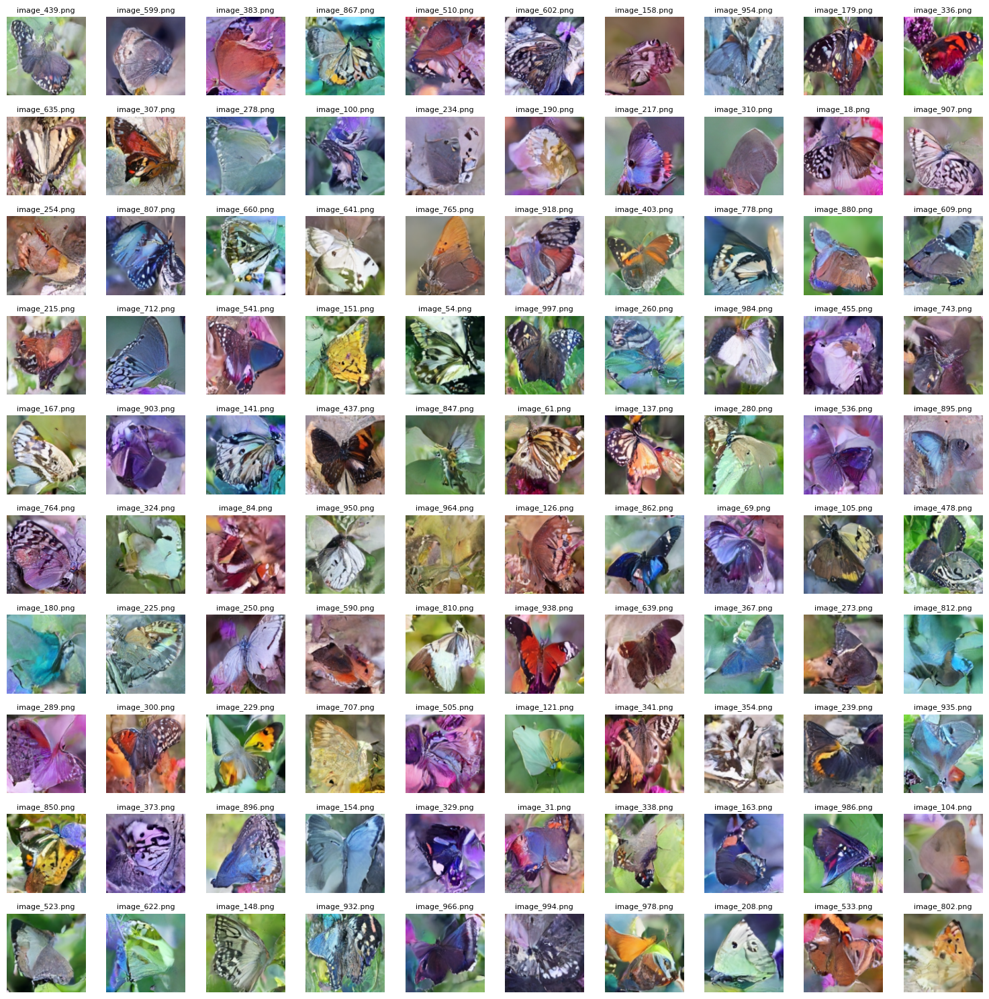

In [22]:
# Here are some of the generated images using DDIM Scheduler and UNet model we trained in Question 1
display(Image(filename='Images/DDIMSample.png'))

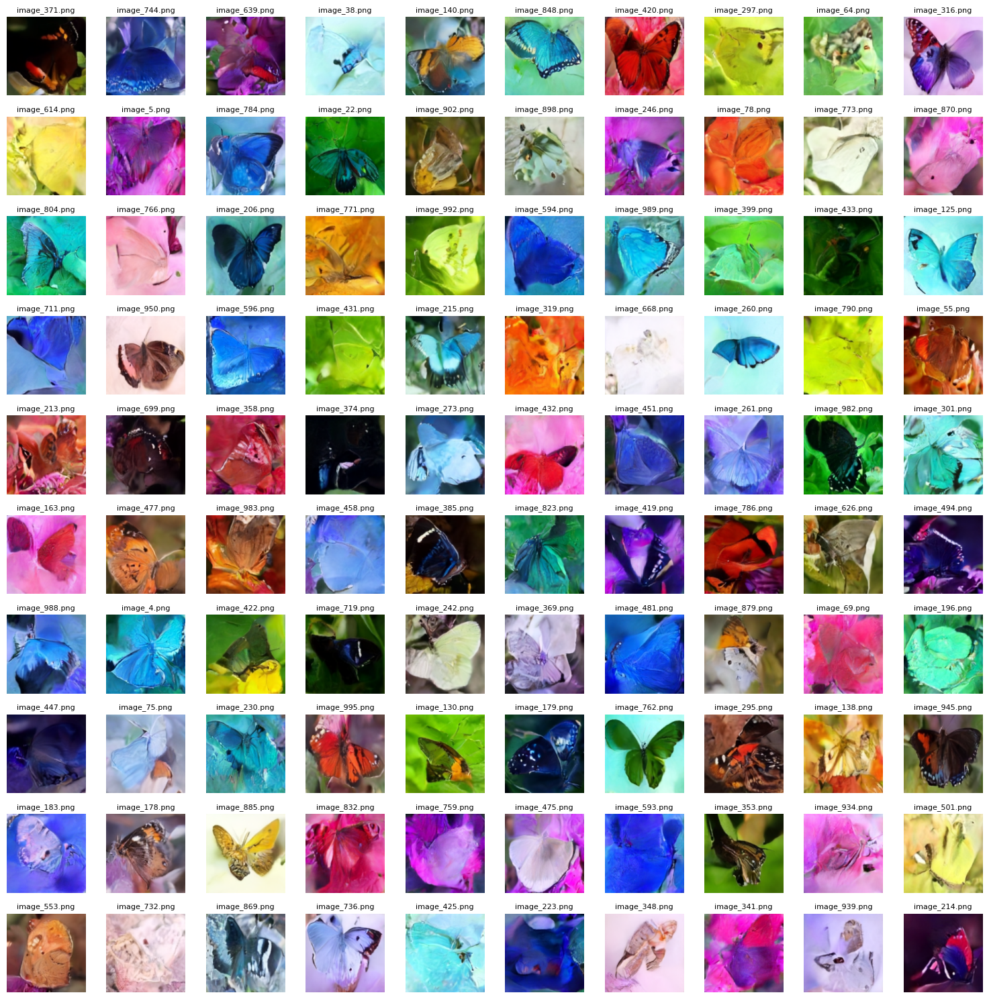

In [23]:
# Here are some of the generated images using DDPM Scheduler and UNet model we trained in Question 1
display(Image(filename='Images/DDPMSample.png'))

In [ ]:
# FID Calculations

# FID Between 1000 generated images using DDIM Scheduler and 1000 images from training set
# 1. FID calculated using our implementation - 244.69
# 2. FID calculated using builtin pytorch implementation - 343.94

# FID Between 1000 generated images using DDPM Scheduler and 1000 images from training set
# 1. FID calculated using our implementation - 234.43
# 2. FID calculated using builtin pytorch implementation - 345.79

# FID Between 1000 generated images using DDIM Scheduler and 1000 generated images using DDPM Scheduler
# 1. FID calculated using our implementation - 63.09
# 2. FID calculated using builtin pytorch implementation - 68.08

# Again the images are clear, still this FID is high and this happened in prev assignments also, maybe there is something wrong with our
# FID calculation which is as follows

import os
import torch
import numpy as np
from torchvision import transforms, models
from torch.utils.data import DataLoader, Dataset
from scipy.linalg import sqrtm
from PIL import Image
import torch.nn as nn

class CustomImageDataset(Dataset):
    def __init__(self, folder_path, transform=None):
        self.folder_path = folder_path
        self.transform = transform
        self.image_files = [
            os.path.join(folder_path, file)
            for file in os.listdir(folder_path)
            if file.lower().endswith(('.png', '.jpg', '.jpeg'))
        ]

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, index):
        img_path = self.image_files[index]
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image

def calculate_fid(dataset1_path, dataset2_path, batch_size=50, dims=2048, device='cuda'):
    # Set up the InceptionV3 model
    inception_model = models.inception_v3(pretrained=True, transform_input=False)
    inception_model.fc = nn.Identity()  # Remove the final classification layer to get features
    inception_model.eval()
    inception_model.to(device)
    
    # Function to get Inception features
    def get_features(dataset_path):
        transform = transforms.Compose([
            transforms.Resize((299, 299)),  # Resize for InceptionV3 input
            transforms.ToTensor(),
            transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
        ])
        dataset = CustomImageDataset(dataset_path, transform=transform)
        dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False)
        
        features = []
        with torch.no_grad():
            for imgs in dataloader:
                imgs = imgs.to(device)
                # Get features from the inception model
                feature = inception_model(imgs)
                features.append(feature.cpu().numpy())
        
        # Concatenate features from all batches
        features = np.concatenate(features, axis=0)
        return features
    
    # Get features for both datasets
    features1 = get_features(dataset1_path)
    features2 = get_features(dataset2_path)
    
    # Calculate mean and covariance of features for both datasets
    mu1, sigma1 = features1.mean(axis=0), np.cov(features1, rowvar=False)
    mu2, sigma2 = features2.mean(axis=0), np.cov(features2, rowvar=False)
    
    # Calculate the FID score using the formula:
    # FID = ||mu1 - mu2||^2 + trace(sigma1 + sigma2 - 2 * sqrt(sigma1 * sigma2))
    diff = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    
    # Numerical stability check for imaginary numbers in covmean
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    
    fid_score = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2 * covmean)
    return fid_score

# Example usage:
dataset1_path = '../ButterflyOutput/generated_imagesDDPM' # change path accordingly
dataset2_path = 'sampled_animals'
fid_score = calculate_fid(dataset1_path, dataset2_path)
print(f"FID score between the datasets: {fid_score}")


# 5. Implement a noise conditional score network and repeat the above experiments. Compare the sampling procedures in terms of speed and generation


In [ ]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import pandas as pd
from dataclasses import dataclass
from diffusers import DDPMScheduler, UNet2DModel
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
from pathlib import Path

@dataclass
class Config:
    image_size = 128
    train_batch_size = 16
    eval_batch_size = 16
    num_epochs = 20
    learning_rate = 1e-4
    classifier_lr = 1e-4
    guidance_scale = 3.0
    num_inference_steps = 1000  # Increased for better training stability
    seed = 42
    output_dir = "butterfly_guided_output"

# [Previous dataset and classifier classes remain the same...]
class ButterflyDataset(Dataset):
    def __init__(self, csv_file, img_dir, transform=None):
        self.annotations = pd.read_csv(csv_file)
        self.img_dir = img_dir
        self.transform = transform
        self.classes = sorted(self.annotations['label'].unique())
        self.class_to_idx = {cls: idx for idx, cls in enumerate(self.classes)}
        
    def __len__(self):
        return len(self.annotations)
    
    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.annotations.iloc[idx, 0])
        image = Image.open(img_path).convert('RGB')
        label = self.class_to_idx[self.annotations.iloc[idx, 1]]
        
        if self.transform:
            image = self.transform(image)
            
        return image, label

class ButterflyClassifier(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 64, 3, padding=1)
        self.conv2 = nn.Conv2d(64, 128, 3, padding=1)
        self.conv3 = nn.Conv2d(128, 256, 3, padding=1)
        self.pool = nn.MaxPool2d(2, 2)
        self.fc1 = nn.Linear(256 * 16 * 16, 512)
        self.fc2 = nn.Linear(512, num_classes)
        self.dropout = nn.Dropout(0.5)
        
    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = self.pool(x)
        x = F.relu(self.conv2(x))
        x = self.pool(x)
        x = F.relu(self.conv3(x))
        x = self.pool(x)
        x = x.view(-1, 256 * 16 * 16)
        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = self.fc2(x)
        return x

def train_classifier(classifier, dataloader, num_epochs, device):
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(classifier.parameters(), lr=Config.classifier_lr)
    
    classifier.train()
    for epoch in range(num_epochs):
        running_loss = 0.0
        for images, labels in tqdm(dataloader, desc=f"Classifier Epoch {epoch+1}"):
            images, labels = images.to(device), labels.to(device)
            
            optimizer.zero_grad()
            outputs = classifier(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            
            running_loss += loss.item()
            
        print(f"Epoch {epoch+1}, Loss: {running_loss/len(dataloader):.4f}")

def get_classifier_guidance(noisy_images, classifier, target_labels, guidance_scale):
    """Compute classifier gradients for guidance"""
    # Create a copy of the input that requires gradients
    noisy_images_with_grad = noisy_images.detach().requires_grad_(True)
    
    # Get classifier predictions
    class_scores = classifier(noisy_images_with_grad)
    class_loss = F.cross_entropy(class_scores, target_labels)
    
    # Compute gradients
    gradients = torch.autograd.grad(class_loss, noisy_images_with_grad)[0]
    
    return guidance_scale * gradients

def train_guided_diffusion(config, unet, classifier, noise_scheduler, dataloader, device):
    optimizer = torch.optim.AdamW(unet.parameters(), lr=config.learning_rate)
    
    unet.train()
    classifier.eval()
    
    for epoch in range(config.num_epochs):
        progress_bar = tqdm(total=len(dataloader), desc=f"Diffusion Epoch {epoch+1}")
        total_loss = 0
        
        for step, (clean_images, labels) in enumerate(dataloader):
            clean_images = clean_images.to(device)
            labels = labels.to(device)
            
            # Sample noise and timesteps
            noise = torch.randn_like(clean_images)
            timesteps = torch.randint(0, noise_scheduler.config.num_train_timesteps, (clean_images.shape[0],), device=device)
            
            # Add noise according to the noise schedule
            noisy_images = noise_scheduler.add_noise(clean_images, noise, timesteps)
            
            # Get model prediction
            noise_pred = unet(noisy_images, timesteps, return_dict=False)[0]
            
            # Get classifier guidance
            guidance = get_classifier_guidance(noisy_images, classifier, labels, config.guidance_scale)
            
            # Combine the gradients
            guided_noise_pred = noise_pred - guidance
            
            # Calculate loss
            loss = F.mse_loss(guided_noise_pred, noise)
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            total_loss += loss.item()
            progress_bar.update(1)
            progress_bar.set_postfix(loss=loss.item())
        
        avg_loss = total_loss / len(dataloader)
        print(f"Epoch {epoch+1} average loss: {avg_loss:.4f}")
def generate_class_samples(unet, classifier, noise_scheduler, num_classes, device, config):
    unet.eval()
    classifier.eval()
    
    # Create output directory
    os.makedirs(config.output_dir, exist_ok=True)
    
    # Generate one image per class
    for class_idx in range(num_classes):
        # Start from random noise
        image = torch.randn(1, 3, config.image_size, config.image_size).to(device)
        target_label = torch.tensor([class_idx], device=device)
        
        # Denoising loop
        for t in tqdm(reversed(range(config.num_inference_steps)), desc=f"Generating class {class_idx}"):
            # Convert t to tensor
            timesteps = torch.tensor([t], device=device)
            
            # Predict noise residual
            with torch.no_grad():
                noise_pred = unet(image, timesteps, return_dict=False)[0]
            
            # Get classifier guidance (will handle grad requirements internally)
            guidance = get_classifier_guidance(image, classifier, target_label, config.guidance_scale)
            
            # Combine predictions
            noise_pred = noise_pred - guidance
            
            # Scheduler step
            scheduler_output = noise_scheduler.step(noise_pred, t, image)
            image = scheduler_output.prev_sample
            
        # Save generated image
        image_array = (image[0].cpu().permute(1, 2, 0).numpy() * 127.5 + 127.5).clip(0, 255).astype('uint8')
        Image.fromarray(image_array).save(f"{config.output_dir}/class_{class_idx}.png")

def setup_unet(config, device):
    return UNet2DModel(
        sample_size=config.image_size,
        in_channels=3,
        out_channels=3,
        layers_per_block=2,
        block_out_channels=(128, 128, 256, 256, 512, 512),
        down_block_types=(
            "DownBlock2D",
            "DownBlock2D",
            "DownBlock2D",
            "DownBlock2D",
            "AttnDownBlock2D",
            "DownBlock2D",
        ),
        up_block_types=(
            "UpBlock2D",
            "AttnUpBlock2D",
            "UpBlock2D",
            "UpBlock2D",
            "UpBlock2D",
            "UpBlock2D",
        ),
    ).to(device)

def main():
    # Setup
    config = Config()
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")
    torch.manual_seed(config.seed)
    
    # Data preprocessing
    transform = transforms.Compose([
        transforms.Resize((config.image_size, config.image_size)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
    
    # Dataset and DataLoader
    dataset = ButterflyDataset(
        csv_file="/home/smehul/Desktop/Q5/archive/Training_set.csv",
        img_dir="/home/smehul/Desktop/Q5/archive/train",
        transform=transform
    )
    dataloader = DataLoader(dataset, batch_size=config.train_batch_size, shuffle=True)
    
    # Initialize models
    num_classes = len(dataset.classes)
    classifier = ButterflyClassifier(num_classes).to(device)
    unet = setup_unet(config, device)
    noise_scheduler = DDPMScheduler(num_train_timesteps=config.num_inference_steps)
    
    # Training
    print("Training classifier...")
    train_classifier(classifier, dataloader, num_epochs=20, device=device)
    
    print("Training diffusion model with classifier guidance...")
    train_guided_diffusion(config, unet, classifier, noise_scheduler, dataloader, device)
    
    # Generate samples
    print("Generating class-conditional samples...")
    generate_class_samples(unet, classifier, noise_scheduler, num_classes, device, config)


if __name__ == "__main__":
    main()


/home/smehul/miniconda3/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Using device: cuda
Training classifier...


Classifier Epoch 1: 100%|██████████| 407/407 [00:13<00:00, 29.52it/s]


Epoch 1, Loss: 3.6754


Classifier Epoch 2: 100%|██████████| 407/407 [00:12<00:00, 31.85it/s]


Epoch 2, Loss: 2.6473


Classifier Epoch 3: 100%|██████████| 407/407 [00:12<00:00, 31.69it/s]


Epoch 3, Loss: 2.0785


Classifier Epoch 4: 100%|██████████| 407/407 [00:12<00:00, 31.52it/s]


Epoch 4, Loss: 1.7144


Classifier Epoch 5: 100%|██████████| 407/407 [00:12<00:00, 31.32it/s]


Epoch 5, Loss: 1.4312


Classifier Epoch 6: 100%|██████████| 407/407 [00:13<00:00, 31.11it/s]


Epoch 6, Loss: 1.2397


Classifier Epoch 7: 100%|██████████| 407/407 [00:13<00:00, 31.12it/s]


Epoch 7, Loss: 1.0538


Classifier Epoch 8: 100%|██████████| 407/407 [00:13<00:00, 30.83it/s]


Epoch 8, Loss: 0.9137


Classifier Epoch 9: 100%|██████████| 407/407 [00:13<00:00, 30.77it/s]


Epoch 9, Loss: 0.7748


Classifier Epoch 10: 100%|██████████| 407/407 [00:13<00:00, 31.02it/s]


Epoch 10, Loss: 0.6666


Classifier Epoch 11: 100%|██████████| 407/407 [00:11<00:00, 34.68it/s]


Epoch 11, Loss: 0.5715


Classifier Epoch 12: 100%|██████████| 407/407 [00:11<00:00, 34.86it/s]


Epoch 12, Loss: 0.4850


Classifier Epoch 13: 100%|██████████| 407/407 [00:12<00:00, 32.67it/s]


Epoch 13, Loss: 0.4489


Classifier Epoch 14: 100%|██████████| 407/407 [00:13<00:00, 31.20it/s]


Epoch 14, Loss: 0.3651


Classifier Epoch 15: 100%|██████████| 407/407 [00:13<00:00, 30.99it/s]


Epoch 15, Loss: 0.3135


Classifier Epoch 16: 100%|██████████| 407/407 [00:13<00:00, 31.29it/s]


Epoch 16, Loss: 0.2707


Classifier Epoch 17: 100%|██████████| 407/407 [00:13<00:00, 31.22it/s]


Epoch 17, Loss: 0.2594


Classifier Epoch 18: 100%|██████████| 407/407 [00:12<00:00, 31.74it/s]


Epoch 18, Loss: 0.2279


Classifier Epoch 19: 100%|██████████| 407/407 [00:12<00:00, 32.16it/s]


Epoch 19, Loss: 0.2089


Classifier Epoch 20: 100%|██████████| 407/407 [00:12<00:00, 31.60it/s]


Epoch 20, Loss: 0.1900
Training diffusion model with classifier guidance...


Diffusion Epoch 1: 100%|██████████| 407/407 [03:17<00:00,  3.23it/s, loss=0.00747]

Epoch 1 average loss: 0.0619


Diffusion Epoch 1: 100%|██████████| 407/407 [03:17<00:00,  2.07it/s, loss=0.00747]


Epoch 2 average loss: 0.0296


Diffusion Epoch 3: 100%|██████████| 407/407 [02:38<00:00,  3.30it/s, loss=0.00832]

Epoch 3 average loss: 0.0269


Diffusion Epoch 3: 100%|██████████| 407/407 [02:38<00:00,  2.57it/s, loss=0.00832]


Epoch 4 average loss: 0.0252


Diffusion Epoch 5: 100%|██████████| 407/407 [03:41<00:00,  2.22it/s, loss=0.139]  

Epoch 5 average loss: 0.0240


Diffusion Epoch 5: 100%|██████████| 407/407 [03:41<00:00,  1.84it/s, loss=0.139]


Epoch 6 average loss: 0.0243


Diffusion Epoch 7: 100%|██████████| 407/407 [03:53<00:00,  2.22it/s, loss=0.0598] 

Epoch 7 average loss: 0.0245


Diffusion Epoch 7: 100%|██████████| 407/407 [03:53<00:00,  1.74it/s, loss=0.0598]


Epoch 8 average loss: 0.0233


Diffusion Epoch 9: 100%|██████████| 407/407 [03:54<00:00,  2.21it/s, loss=0.015]  

Epoch 9 average loss: 0.0220


Diffusion Epoch 9: 100%|██████████| 407/407 [03:54<00:00,  1.74it/s, loss=0.015]


Epoch 10 average loss: 0.0232


Diffusion Epoch 11: 100%|██████████| 407/407 [03:07<00:00,  3.27it/s, loss=0.00819]

Epoch 11 average loss: 0.0220


Diffusion Epoch 11: 100%|██████████| 407/407 [03:07<00:00,  2.17it/s, loss=0.00819]


Epoch 12 average loss: 0.0215


Diffusion Epoch 13: 100%|██████████| 407/407 [03:13<00:00,  2.23it/s, loss=0.0658] 

Epoch 13 average loss: 0.0211


Diffusion Epoch 13: 100%|██████████| 407/407 [03:13<00:00,  2.11it/s, loss=0.0658]


Epoch 14 average loss: 0.0220


Diffusion Epoch 15: 100%|██████████| 407/407 [03:53<00:00,  2.21it/s, loss=0.00512]

Epoch 15 average loss: 0.0206


Diffusion Epoch 15: 100%|██████████| 407/407 [03:53<00:00,  1.75it/s, loss=0.00512]


Epoch 16 average loss: 0.0207


Diffusion Epoch 17: 100%|██████████| 407/407 [03:50<00:00,  2.21it/s, loss=0.00859]

Epoch 17 average loss: 0.0209


Diffusion Epoch 17: 100%|██████████| 407/407 [03:50<00:00,  1.77it/s, loss=0.00859]


Epoch 18 average loss: 0.0205


Diffusion Epoch 19: 100%|██████████| 407/407 [03:54<00:00,  2.32it/s, loss=0.00851]

Epoch 19 average loss: 0.0207


Diffusion Epoch 20: 100%|██████████| 407/407 [03:44<00:00,  1.81it/s, loss=0.0208]


Epoch 20 average loss: 0.0202
Generating class-conditional samples...


Generating class 0: 1000it [00:20, 48.88it/s]
Generating class 1: 1000it [00:20, 48.91it/s]
Generating class 2: 1000it [00:20, 48.91it/s]
Generating class 3: 1000it [00:19, 50.81it/s]
Generating class 4: 1000it [00:18, 54.09it/s]
Generating class 5: 1000it [00:19, 52.20it/s]
Generating class 6: 1000it [00:20, 48.87it/s]
Generating class 7: 1000it [00:20, 48.97it/s]
Generating class 8: 1000it [00:20, 48.89it/s]
Generating class 9: 1000it [00:20, 48.92it/s]
Generating class 10: 1000it [00:20, 48.92it/s]
Generating class 11: 1000it [00:20, 48.89it/s]
Generating class 12: 1000it [00:20, 48.97it/s]
Generating class 13: 1000it [00:20, 48.93it/s]
Generating class 14: 1000it [00:20, 48.91it/s]
Generating class 15: 1000it [00:20, 48.98it/s]
Generating class 16: 1000it [00:20, 48.92it/s]
Generating class 17: 1000it [00:20, 48.90it/s]
Generating class 18: 1000it [00:20, 48.91it/s]
Generating class 19: 1000it [00:20, 48.96it/s]
Generating class 20: 1000it [00:20, 49.80it/s]
Generating class 21: 10

# Plot all Classes

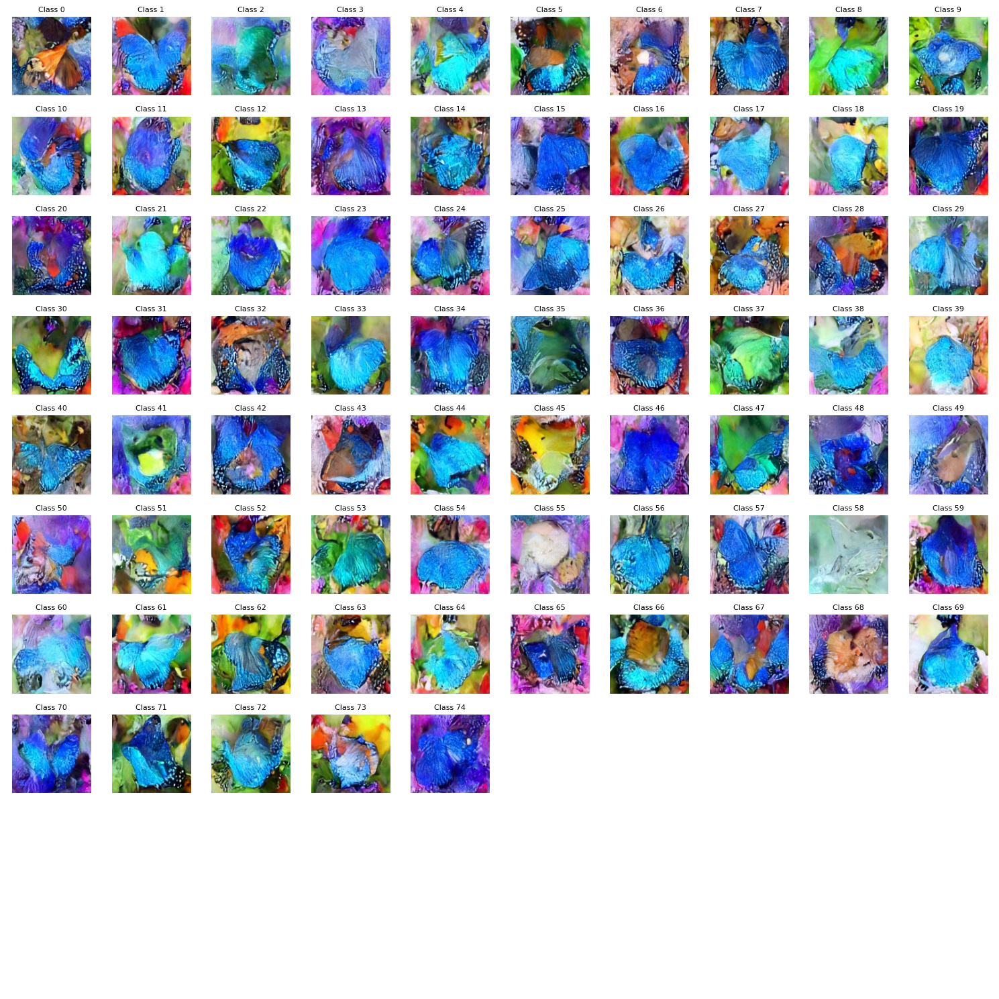

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the directory containing the images
image_dir = "/home/smehul/Desktop/Q5/butterfly_guided_output"

# List all image files in the directory
image_files = sorted([os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.endswith('.png')])

# Number of rows and columns for the grid
rows, cols = 10, 10

# Create a figure
fig, axes = plt.subplots(rows, cols, figsize=(15, 15))
fig.subplots_adjust(hspace=0.5, wspace=0.5)  # Adjust spacing between images

# Loop over the grid and add images
for i in range(rows * cols):
    ax = axes[i // cols, i % cols]  # Get the correct subplot
    if i < len(image_files):  # Check if the image exists
        img = Image.open(image_files[i])
        ax.imshow(img)
        ax.set_title(f"Class {i}", fontsize=8)  # Add class title
    ax.axis('off')  # Turn off axes

# Show the plot
plt.tight_layout()
plt.show()


# Let's try with 40 epochs

In [ ]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import pandas as pd
from dataclasses import dataclass
from diffusers import DDPMScheduler, UNet2DModel
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
from pathlib import Path

@dataclass
class Config:
    image_size = 128
    train_batch_size = 16
    eval_batch_size = 16
    num_epochs = 30
    learning_rate = 1e-4
    classifier_lr = 1e-4
    guidance_scale = 3.0
    num_inference_steps = 1000  # Increased for better training stability
    seed = 42
    output_dir = "butterfly_guided_output_more_epoch"

# [Previous dataset and classifier classes remain the same...]
class ButterflyDataset(Dataset):
    def __init__(self, csv_file, img_dir, transform=None):
        self.annotations = pd.read_csv(csv_file)
        self.img_dir = img_dir
        self.transform = transform
        self.classes = sorted(self.annotations['label'].unique())
        self.class_to_idx = {cls: idx for idx, cls in enumerate(self.classes)}
        
    def __len__(self):
        return len(self.annotations)
    
    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.annotations.iloc[idx, 0])
        image = Image.open(img_path).convert('RGB')
        label = self.class_to_idx[self.annotations.iloc[idx, 1]]
        
        if self.transform:
            image = self.transform(image)
            
        return image, label

class ButterflyClassifier(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 64, 3, padding=1)
        self.conv2 = nn.Conv2d(64, 128, 3, padding=1)
        self.conv3 = nn.Conv2d(128, 256, 3, padding=1)
        self.pool = nn.MaxPool2d(2, 2)
        self.fc1 = nn.Linear(256 * 16 * 16, 512)
        self.fc2 = nn.Linear(512, num_classes)
        self.dropout = nn.Dropout(0.5)
        
    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = self.pool(x)
        x = F.relu(self.conv2(x))
        x = self.pool(x)
        x = F.relu(self.conv3(x))
        x = self.pool(x)
        x = x.view(-1, 256 * 16 * 16)
        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = self.fc2(x)
        return x

def train_classifier(classifier, dataloader, num_epochs, device):
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(classifier.parameters(), lr=Config.classifier_lr)
    
    classifier.train()
    for epoch in range(num_epochs):
        running_loss = 0.0
        for images, labels in tqdm(dataloader, desc=f"Classifier Epoch {epoch+1}"):
            images, labels = images.to(device), labels.to(device)
            
            optimizer.zero_grad()
            outputs = classifier(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            
            running_loss += loss.item()
            
        print(f"Epoch {epoch+1}, Loss: {running_loss/len(dataloader):.4f}")

def get_classifier_guidance(noisy_images, classifier, target_labels, guidance_scale):
    """Compute classifier gradients for guidance"""
    # Create a copy of the input that requires gradients
    noisy_images_with_grad = noisy_images.detach().requires_grad_(True)
    
    # Get classifier predictions
    class_scores = classifier(noisy_images_with_grad)
    class_loss = F.cross_entropy(class_scores, target_labels)
    
    # Compute gradients
    gradients = torch.autograd.grad(class_loss, noisy_images_with_grad)[0]
    
    return guidance_scale * gradients

def train_guided_diffusion(config, unet, classifier, noise_scheduler, dataloader, device):
    optimizer = torch.optim.AdamW(unet.parameters(), lr=config.learning_rate)
    
    unet.train()
    classifier.eval()
    
    for epoch in range(config.num_epochs):
        progress_bar = tqdm(total=len(dataloader), desc=f"Diffusion Epoch {epoch+1}")
        total_loss = 0
        
        for step, (clean_images, labels) in enumerate(dataloader):
            clean_images = clean_images.to(device)
            labels = labels.to(device)
            
            # Sample noise and timesteps
            noise = torch.randn_like(clean_images)
            timesteps = torch.randint(0, noise_scheduler.config.num_train_timesteps, (clean_images.shape[0],), device=device)
            
            # Add noise according to the noise schedule
            noisy_images = noise_scheduler.add_noise(clean_images, noise, timesteps)
            
            # Get model prediction
            noise_pred = unet(noisy_images, timesteps, return_dict=False)[0]
            
            # Get classifier guidance
            guidance = get_classifier_guidance(noisy_images, classifier, labels, config.guidance_scale)
            
            # Combine the gradients
            guided_noise_pred = noise_pred - guidance
            
            # Calculate loss
            loss = F.mse_loss(guided_noise_pred, noise)
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            total_loss += loss.item()
            progress_bar.update(1)
            progress_bar.set_postfix(loss=loss.item())
        
        avg_loss = total_loss / len(dataloader)
        print(f"Epoch {epoch+1} average loss: {avg_loss:.4f}")
def generate_class_samples(unet, classifier, noise_scheduler, num_classes, device, config):
    unet.eval()
    classifier.eval()
    
    # Create output directory
    os.makedirs(config.output_dir, exist_ok=True)
    
    # Generate one image per class
    for class_idx in range(num_classes):
        # Start from random noise
        image = torch.randn(1, 3, config.image_size, config.image_size).to(device)
        target_label = torch.tensor([class_idx], device=device)
        
        # Denoising loop
        for t in tqdm(reversed(range(config.num_inference_steps)), desc=f"Generating class {class_idx}"):
            # Convert t to tensor
            timesteps = torch.tensor([t], device=device)
            
            # Predict noise residual
            with torch.no_grad():
                noise_pred = unet(image, timesteps, return_dict=False)[0]
            
            # Get classifier guidance (will handle grad requirements internally)
            guidance = get_classifier_guidance(image, classifier, target_label, config.guidance_scale)
            
            # Combine predictions
            noise_pred = noise_pred - guidance
            
            # Scheduler step
            scheduler_output = noise_scheduler.step(noise_pred, t, image)
            image = scheduler_output.prev_sample
            
        # Save generated image
        image_array = (image[0].cpu().permute(1, 2, 0).numpy() * 127.5 + 127.5).clip(0, 255).astype('uint8')
        Image.fromarray(image_array).save(f"{config.output_dir}/class_{class_idx}.png")

def setup_unet(config, device):
    return UNet2DModel(
        sample_size=config.image_size,
        in_channels=3,
        out_channels=3,
        layers_per_block=2,
        block_out_channels=(128, 128, 256, 256, 512, 512),
        down_block_types=(
            "DownBlock2D",
            "DownBlock2D",
            "DownBlock2D",
            "DownBlock2D",
            "AttnDownBlock2D",
            "DownBlock2D",
        ),
        up_block_types=(
            "UpBlock2D",
            "AttnUpBlock2D",
            "UpBlock2D",
            "UpBlock2D",
            "UpBlock2D",
            "UpBlock2D",
        ),
    ).to(device)

def main():
    # Setup
    config = Config()
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")
    torch.manual_seed(config.seed)
    
    # Data preprocessing
    transform = transforms.Compose([
        transforms.Resize((config.image_size, config.image_size)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
    
    # Dataset and DataLoader
    dataset = ButterflyDataset(
        csv_file="/home/smehul/Desktop/Q5/archive/Training_set.csv",
        img_dir="/home/smehul/Desktop/Q5/archive/train",
        transform=transform
    )
    dataloader = DataLoader(dataset, batch_size=config.train_batch_size, shuffle=True)
    
    # Initialize models
    num_classes = len(dataset.classes)
    classifier = ButterflyClassifier(num_classes).to(device)
    unet = setup_unet(config, device)
    noise_scheduler = DDPMScheduler(num_train_timesteps=config.num_inference_steps)
    
    # Training
    print("Training classifier...")
    train_classifier(classifier, dataloader, num_epochs=30, device=device)
    
    print("Training diffusion model with classifier guidance...")
    train_guided_diffusion(config, unet, classifier, noise_scheduler, dataloader, device)
    
    # Generate samples
    print("Generating class-conditional samples...")
    generate_class_samples(unet, classifier, noise_scheduler, num_classes, device, config)








if __name__ == "__main__":
    main()


Using device: cuda
Training classifier...


Classifier Epoch 1: 100%|██████████| 407/407 [00:10<00:00, 40.26it/s]


Epoch 1, Loss: 3.6754


Classifier Epoch 2: 100%|██████████| 407/407 [00:10<00:00, 40.43it/s]


Epoch 2, Loss: 2.6473


Classifier Epoch 3: 100%|██████████| 407/407 [00:10<00:00, 40.36it/s]


Epoch 3, Loss: 2.0785


Classifier Epoch 4: 100%|██████████| 407/407 [00:10<00:00, 40.41it/s]


Epoch 4, Loss: 1.7144


Classifier Epoch 5: 100%|██████████| 407/407 [00:10<00:00, 40.44it/s]


Epoch 5, Loss: 1.4312


Classifier Epoch 6: 100%|██████████| 407/407 [00:10<00:00, 40.40it/s]


Epoch 6, Loss: 1.2397


Classifier Epoch 7: 100%|██████████| 407/407 [00:10<00:00, 40.33it/s]


Epoch 7, Loss: 1.0538


Classifier Epoch 8: 100%|██████████| 407/407 [00:10<00:00, 40.44it/s]


Epoch 8, Loss: 0.9137


Classifier Epoch 9: 100%|██████████| 407/407 [00:10<00:00, 40.36it/s]


Epoch 9, Loss: 0.7748


Classifier Epoch 10: 100%|██████████| 407/407 [00:10<00:00, 40.41it/s]


Epoch 10, Loss: 0.6666


Classifier Epoch 11: 100%|██████████| 407/407 [00:10<00:00, 40.34it/s]


Epoch 11, Loss: 0.5715


Classifier Epoch 12: 100%|██████████| 407/407 [00:09<00:00, 40.89it/s]


Epoch 12, Loss: 0.4850


Classifier Epoch 13: 100%|██████████| 407/407 [00:08<00:00, 48.22it/s]


Epoch 13, Loss: 0.4489


Classifier Epoch 14: 100%|██████████| 407/407 [00:09<00:00, 44.01it/s]


Epoch 14, Loss: 0.3651


Classifier Epoch 15: 100%|██████████| 407/407 [00:10<00:00, 40.34it/s]


Epoch 15, Loss: 0.3135


Classifier Epoch 16: 100%|██████████| 407/407 [00:10<00:00, 40.39it/s]


Epoch 16, Loss: 0.2707


Classifier Epoch 17: 100%|██████████| 407/407 [00:10<00:00, 40.50it/s]


Epoch 17, Loss: 0.2594


Classifier Epoch 18: 100%|██████████| 407/407 [00:10<00:00, 40.56it/s]


Epoch 18, Loss: 0.2279


Classifier Epoch 19: 100%|██████████| 407/407 [00:10<00:00, 40.56it/s]


Epoch 19, Loss: 0.2089


Classifier Epoch 20: 100%|██████████| 407/407 [00:10<00:00, 40.57it/s]


Epoch 20, Loss: 0.1900


Classifier Epoch 21: 100%|██████████| 407/407 [00:10<00:00, 40.62it/s]


Epoch 21, Loss: 0.1707


Classifier Epoch 22: 100%|██████████| 407/407 [00:10<00:00, 40.59it/s]


Epoch 22, Loss: 0.1469


Classifier Epoch 23: 100%|██████████| 407/407 [00:10<00:00, 40.59it/s]


Epoch 23, Loss: 0.1488


Classifier Epoch 24: 100%|██████████| 407/407 [00:10<00:00, 40.63it/s]


Epoch 24, Loss: 0.1542


Classifier Epoch 25: 100%|██████████| 407/407 [00:10<00:00, 40.61it/s]


Epoch 25, Loss: 0.1329


Classifier Epoch 26: 100%|██████████| 407/407 [00:10<00:00, 40.64it/s]


Epoch 26, Loss: 0.1231


Classifier Epoch 27: 100%|██████████| 407/407 [00:09<00:00, 40.71it/s]


Epoch 27, Loss: 0.1177


Classifier Epoch 28: 100%|██████████| 407/407 [00:09<00:00, 40.71it/s]


Epoch 28, Loss: 0.1166


Classifier Epoch 29: 100%|██████████| 407/407 [00:10<00:00, 40.67it/s]


Epoch 29, Loss: 0.0940


Classifier Epoch 30: 100%|██████████| 407/407 [00:10<00:00, 40.60it/s]


Epoch 30, Loss: 0.0936
Training diffusion model with classifier guidance...


Diffusion Epoch 1: 100%|██████████| 407/407 [02:38<00:00,  2.56it/s, loss=0.0496] 

Epoch 1 average loss: 0.0626


Diffusion Epoch 1: 100%|██████████| 407/407 [02:38<00:00,  2.57it/s, loss=0.0496]


Epoch 2 average loss: 0.0326


Diffusion Epoch 3: 100%|██████████| 407/407 [02:35<00:00,  2.56it/s, loss=0.0111] 

Epoch 3 average loss: 0.0278


Diffusion Epoch 3: 100%|██████████| 407/407 [02:35<00:00,  2.62it/s, loss=0.0111]


Epoch 4 average loss: 0.0250


Diffusion Epoch 5: 100%|██████████| 407/407 [02:38<00:00,  3.29it/s, loss=0.00497]

Epoch 5 average loss: 0.0256


Diffusion Epoch 5: 100%|██████████| 407/407 [02:38<00:00,  2.56it/s, loss=0.00497]


Epoch 6 average loss: 0.0239


Diffusion Epoch 7: 100%|██████████| 407/407 [02:35<00:00,  3.28it/s, loss=0.00445]

Epoch 7 average loss: 0.0230


Diffusion Epoch 7: 100%|██████████| 407/407 [02:35<00:00,  2.63it/s, loss=0.00445]


Epoch 8 average loss: 0.0219


Diffusion Epoch 9: 100%|██████████| 407/407 [02:38<00:00,  3.28it/s, loss=0.0252] 

Epoch 9 average loss: 0.0230


Diffusion Epoch 9: 100%|██████████| 407/407 [02:38<00:00,  2.56it/s, loss=0.0252]


Epoch 10 average loss: 0.0213


Diffusion Epoch 11: 100%|██████████| 407/407 [02:34<00:00,  2.56it/s, loss=0.00155]

Epoch 11 average loss: 0.0216


Diffusion Epoch 11: 100%|██████████| 407/407 [02:34<00:00,  2.63it/s, loss=0.00155]


Epoch 12 average loss: 0.0218


Diffusion Epoch 13: 100%|██████████| 407/407 [02:38<00:00,  2.56it/s, loss=0.00343]

Epoch 13 average loss: 0.0212


Diffusion Epoch 13: 100%|██████████| 407/407 [02:38<00:00,  2.57it/s, loss=0.00343]


Epoch 14 average loss: 0.0217


Diffusion Epoch 15: 100%|██████████| 407/407 [02:34<00:00,  3.30it/s, loss=0.0142] 

Epoch 15 average loss: 0.0210


Diffusion Epoch 15: 100%|██████████| 407/407 [02:34<00:00,  2.63it/s, loss=0.0142]


Epoch 16 average loss: 0.0210


Diffusion Epoch 17: 100%|██████████| 407/407 [02:38<00:00,  3.30it/s, loss=0.00347]

Epoch 17 average loss: 0.0201


Diffusion Epoch 17: 100%|██████████| 407/407 [02:38<00:00,  2.57it/s, loss=0.00347]


Epoch 18 average loss: 0.0218


Diffusion Epoch 19: 100%|██████████| 407/407 [02:37<00:00,  2.93it/s, loss=0.0178] 

Epoch 19 average loss: 0.0210


Diffusion Epoch 19: 100%|██████████| 407/407 [02:37<00:00,  2.59it/s, loss=0.0178]


Epoch 20 average loss: 0.0205


Diffusion Epoch 21: 100%|██████████| 407/407 [02:38<00:00,  3.28it/s, loss=0.0107] 

Epoch 21 average loss: 0.0201


Diffusion Epoch 21: 100%|██████████| 407/407 [02:38<00:00,  2.56it/s, loss=0.0107]


Epoch 22 average loss: 0.0212


Diffusion Epoch 23: 100%|██████████| 407/407 [02:38<00:00,  3.28it/s, loss=0.00161]

Epoch 23 average loss: 0.0213


Diffusion Epoch 23: 100%|██████████| 407/407 [02:38<00:00,  2.56it/s, loss=0.00161]


Epoch 24 average loss: 0.0196


Diffusion Epoch 25: 100%|██████████| 407/407 [02:38<00:00,  3.29it/s, loss=0.00195]

Epoch 25 average loss: 0.0210


Diffusion Epoch 25: 100%|██████████| 407/407 [02:38<00:00,  2.57it/s, loss=0.00195]


Epoch 26 average loss: 0.0205


Diffusion Epoch 27: 100%|██████████| 407/407 [02:38<00:00,  2.56it/s, loss=0.0216] 

Epoch 27 average loss: 0.0198


Diffusion Epoch 27: 100%|██████████| 407/407 [02:38<00:00,  2.57it/s, loss=0.0216]


Epoch 28 average loss: 0.0205


Diffusion Epoch 29: 100%|██████████| 407/407 [02:38<00:00,  3.30it/s, loss=0.0854] 

Epoch 29 average loss: 0.0209


Diffusion Epoch 30: 100%|██████████| 407/407 [02:38<00:00,  2.57it/s, loss=0.0197]


Epoch 30 average loss: 0.0202
Generating class-conditional samples...


Generating class 0: 1000it [00:13, 72.60it/s]
Generating class 1: 1000it [00:13, 72.59it/s]
Generating class 2: 1000it [00:13, 72.62it/s]
Generating class 3: 1000it [00:13, 72.66it/s]
Generating class 4: 1000it [00:13, 72.74it/s]
Generating class 5: 1000it [00:13, 72.75it/s]
Generating class 6: 1000it [00:13, 72.68it/s]
Generating class 7: 1000it [00:13, 72.70it/s]
Generating class 8: 1000it [00:13, 72.72it/s]
Generating class 9: 1000it [00:13, 72.66it/s]
Generating class 10: 1000it [00:13, 72.72it/s]
Generating class 11: 1000it [00:13, 72.44it/s]
Generating class 12: 1000it [00:13, 72.73it/s]
Generating class 13: 1000it [00:13, 72.77it/s]
Generating class 14: 1000it [00:13, 71.55it/s]
Generating class 15: 1000it [00:14, 69.26it/s]
Generating class 16: 1000it [00:13, 72.69it/s]
Generating class 17: 1000it [00:13, 72.71it/s]
Generating class 18: 1000it [00:13, 72.73it/s]
Generating class 19: 1000it [00:13, 72.70it/s]
Generating class 20: 1000it [00:13, 72.70it/s]
Generating class 21: 10

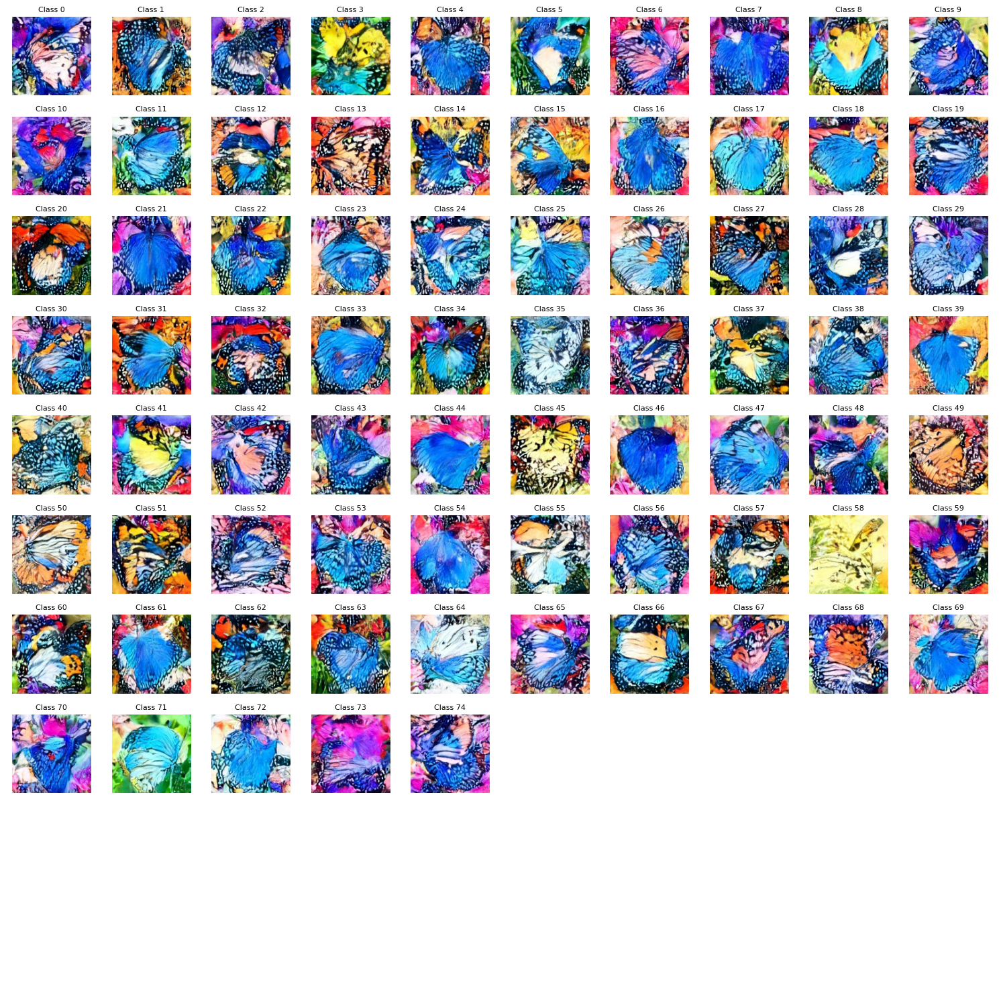

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the directory containing the images
image_dir = "/home/smehul/Desktop/Q5/butterfly_guided_output_more_epoch"

# List all image files in the directory
image_files = sorted([os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.endswith('.png')])

# Number of rows and columns for the grid
rows, cols = 10, 10

# Create a figure
fig, axes = plt.subplots(rows, cols, figsize=(15, 15))
fig.subplots_adjust(hspace=0.5, wspace=0.5)  # Adjust spacing between images

# Loop over the grid and add images
for i in range(rows * cols):
    ax = axes[i // cols, i % cols]  # Get the correct subplot
    if i < len(image_files):  # Check if the image exists
        img = Image.open(image_files[i])
        ax.imshow(img)
        ax.set_title(f"Class {i}", fontsize=8)  # Add class title
    ax.axis('off')  # Turn off axes

# Show the plot
plt.tight_layout()
plt.show()


## Observations and Possible Reasons

After training the Noise Conditional Score Network (NCSN) for **40 epochs**, the generated images exhibit significantly improved brightness and clearer visibility of butterflies compared to those generated after **20 epochs**. This enhancement can be attributed to the following reasons:

1. **Improved Model Convergence:**
   - **Extended Training Duration:** Training the model for more epochs allows it to better learn the underlying data distribution. With additional training, the NCSN fine-tunes its ability to accurately estimate the score function across various noise levels, leading to higher quality and more realistic image generation.
   - **Refined Feature Representation:** More epochs enable the model to capture finer details and nuances in the data, resulting in clearer and more detailed images where subjects like butterflies are more prominently visible.

**Computational Constraints:**
Due to limited computational resources, it was not feasible to train the model for **100 epochs**. Training for more epochs generally continues to improve the model's performance; however, the trade-off with computational time and resource availability necessitated stopping at 40 epochs. Optimizing training efficiency or utilizing more powerful hardware could enable longer training durations in future experiments.



# Question 8: DDIM Inversion

In [ ]:
from diffusers import DDIMPipeline
import PIL.Image
import numpy as np

# load model and scheduler
pipe = DDIMPipeline.from_pretrained("ButterflyOutput")

import os
import torch
from diffusers import UNet2DModel, DDIMScheduler
from accelerate import Accelerator
from PIL import Image
import numpy as np

def preprocess_image(image_path, image_size, device):
    image = Image.open(image_path).convert("RGB")
    image = image.resize((image_size, image_size))
    image = np.array(image).astype(np.float32) / 255.0
    image = torch.from_numpy(image).permute(2, 0, 1)
    image = (image - 0.5) * 2.0
    image = image.unsqueeze(0).to(device)
    return image

# Function to postprocess and save the output image
def save_image(tensor, output_path):
    image = (tensor.squeeze(0).permute(1, 2, 0).cpu().numpy() + 1) / 2  # Rescale to [0, 1]
    image = (image * 255).astype(np.uint8)
    image = Image.fromarray(image)
    image.save(output_path)

# Function to generate an image
def generate_image(
    unet, scheduler, input_image_path=None, output_path="output_image.png", num_inference_steps=50
):
    accelerator = Accelerator()
    unet = accelerator.prepare(unet)
    scheduler = accelerator.prepare(scheduler)

    if input_image_path:
        input_image = preprocess_image(input_image_path).to(accelerator.device)
    else:
        input_image = torch.randn((1, 3, 128, 128), device=accelerator.device)  # Random noise

    scheduler.set_timesteps(num_inference_steps, device=accelerator.device)
    noisy_image = input_image

    for t in scheduler.timesteps:
        with torch.no_grad():
            model_input = noisy_image
            # Predict the noise residual
            noise_pred = unet(model_input, t).sample
            # Compute the previous noisy sample x_t -> x_t-1
            noisy_image = scheduler.step(noise_pred, t, noisy_image).prev_sample

    save_image(noisy_image, output_path)
    print(f"Image saved to {output_path}")

# Paths and configurations
output_folder = "/home/guest_quest_70/adrl/ButterflyOutput"
model_dir = os.path.join(output_folder, "unet")
scheduler_dir = os.path.join(output_folder, "scheduler")
image_path = 'Image_2.jpg'  # Replace with your input image path, or leave None for random noise
output_image_path = os.path.join(output_folder, "generated_image.png")

# Load the model and scheduler
unet = UNet2DModel.from_pretrained(model_dir)
scheduler = DDIMScheduler.from_pretrained(scheduler_dir)

Loading pipeline components...: 100%|██████████| 2/2 [00:00<00:00, 21.95it/s]


In [ ]:
from diffusers import UNet2DModel, DDIMScheduler, DDPMPipeline
from PIL import Image
import numpy as np
import torch
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
import gc

# --- Task 1: Setup pipeline with DDIMScheduler ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
ddim_scheduler = DDIMScheduler(num_train_timesteps=1000)
pipeline = DDPMPipeline(unet=unet, scheduler=ddim_scheduler)
pipeline = pipeline.to(device)

@torch.no_grad()
def preprocess_image(image_path, image_size, device):
    image = Image.open(image_path).convert("RGB")
    image = image.resize((image_size, image_size))
    image = np.array(image).astype(np.float32) / 255.0
    image = torch.from_numpy(image).permute(2, 0, 1)
    image = (image - 0.5) * 2.0
    image = image.unsqueeze(0).to(device)
    return image

@torch.no_grad()
def q_sample(x0, t, scheduler):
    alpha_cumprod = scheduler.alphas_cumprod[t]
    sqrt_alpha_cumprod = alpha_cumprod ** 0.5
    sqrt_one_minus_alpha_cumprod = (1.0 - alpha_cumprod) ** 0.5
    noise = torch.randn_like(x0)
    x_t = sqrt_alpha_cumprod * x0 + sqrt_one_minus_alpha_cumprod * noise
    return x_t, noise

@torch.no_grad()
def interpolate_latents(x_t1, x_t2, num_interpolations=10):
    alphas = torch.linspace(0, 1, num_interpolations, device=x_t1.device)
    return [(1 - alpha) * x_t1 + alpha * x_t2 for alpha in alphas]

@torch.no_grad()
def ddim_reverse_sampling(pipeline, x_t, t_start, num_inference_steps):
    scheduler = pipeline.scheduler
    unet = pipeline.unet
    
    # Set timesteps for reverse process
    scheduler.set_timesteps(num_inference_steps)
    timesteps = scheduler.timesteps
    
    # Find the starting timestep index
    t_start_idx = (timesteps >= t_start).nonzero()[0].item()
    
    # Use only the relevant portion of timesteps
    timesteps = timesteps[t_start_idx:]
    
    latents = x_t.clone()
    
    # Progress bar for the actual steps we're taking
    progress_bar = tqdm(enumerate(timesteps), total=len(timesteps))
    
    for i, t in progress_bar:
        # Clear cache periodically
        if i % 10 == 0:
            torch.cuda.empty_cache()
        
        # Get model output
        model_output = unet(latents, t).sample
        
        # Scheduler step
        latents = scheduler.step(model_output, t, latents).prev_sample
        
        del model_output
    
    # Convert latents to image
    generated_image = (latents + 1.0) / 2.0
    generated_image = generated_image.clamp(0.0, 1.0)
    
    return generated_image

def show_images(images):
    num_images = len(images)
    fig, axs = plt.subplots(1, num_images, figsize=(15, 5))
    if num_images == 1:
        axs = [axs]
    
    for i in range(num_images):
        img = images[i].cpu().squeeze(0).permute(1, 2, 0).numpy()
        axs[i].imshow(img)
        axs[i].axis('off')
    plt.show()
    plt.close()

def run_interpolation(image_path1, image_path2, image_size=128, num_interpolations=10, t_inv=500):
    torch.cuda.empty_cache()
    gc.collect()
    
    print("Processing first image...")
    image1 = preprocess_image(image_path1, image_size, device)
    x_t1, _ = q_sample(image1, t_inv, pipeline.scheduler)
    del image1
    
    print("Processing second image...")
    image2 = preprocess_image(image_path2, image_size, device)
    x_t2, _ = q_sample(image2, t_inv, pipeline.scheduler)
    del image2
    
    print("Generating interpolations...")
    generated_images = []
    interpolated_latents = interpolate_latents(x_t1, x_t2, num_interpolations)
    
    for idx, interp_latent in enumerate(interpolated_latents):
        print(f"Processing interpolation {idx + 1}/{num_interpolations}")
        img = ddim_reverse_sampling(
            pipeline,
            x_t=interp_latent,
            t_start=t_inv,
            num_inference_steps=50  # Reduced for faster processing
        )
        generated_images.append(img.cpu())
        del interp_latent
        torch.cuda.empty_cache()
    
    del x_t1, x_t2, interpolated_latents
    torch.cuda.empty_cache()
    gc.collect()
    
    return generated_images

# Set parameters
t_inv = 500
image_size = 128
num_interpolations = 10  # Reduced for testing

Processing first image...
Processing second image...
Generating interpolations...
Processing interpolation 1/10


100%|██████████| 50/50 [00:01<00:00, 48.64it/s]


Processing interpolation 2/10


100%|██████████| 50/50 [00:00<00:00, 52.25it/s]


Processing interpolation 3/10


100%|██████████| 50/50 [00:00<00:00, 52.41it/s]


Processing interpolation 4/10


100%|██████████| 50/50 [00:00<00:00, 52.01it/s]


Processing interpolation 5/10


100%|██████████| 50/50 [00:00<00:00, 52.53it/s]


Processing interpolation 6/10


100%|██████████| 50/50 [00:00<00:00, 52.31it/s]


Processing interpolation 7/10


100%|██████████| 50/50 [00:00<00:00, 50.91it/s]


Processing interpolation 8/10


100%|██████████| 50/50 [00:00<00:00, 52.03it/s]


Processing interpolation 9/10


100%|██████████| 50/50 [00:01<00:00, 48.06it/s]


Processing interpolation 10/10


100%|██████████| 50/50 [00:00<00:00, 51.41it/s]


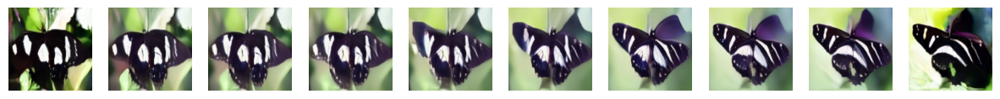

In [ ]:
generated_images = run_interpolation(
    "Image_25.jpg",
    "Image_26.jpg",
    image_size=image_size,
    num_interpolations=num_interpolations,
    t_inv=t_inv
)

show_images(generated_images)

Processing first image...
Processing second image...
Generating interpolations...
Processing interpolation 1/10


100%|██████████| 50/50 [00:00<00:00, 51.91it/s]


Processing interpolation 2/10


100%|██████████| 50/50 [00:00<00:00, 52.63it/s]


Processing interpolation 3/10


100%|██████████| 50/50 [00:00<00:00, 52.57it/s]


Processing interpolation 4/10


100%|██████████| 50/50 [00:00<00:00, 50.20it/s]


Processing interpolation 5/10


100%|██████████| 50/50 [00:01<00:00, 47.68it/s]


Processing interpolation 6/10


100%|██████████| 50/50 [00:00<00:00, 50.84it/s]


Processing interpolation 7/10


100%|██████████| 50/50 [00:00<00:00, 52.97it/s]


Processing interpolation 8/10


100%|██████████| 50/50 [00:00<00:00, 52.26it/s]


Processing interpolation 9/10


100%|██████████| 50/50 [00:00<00:00, 52.27it/s]


Processing interpolation 10/10


100%|██████████| 50/50 [00:00<00:00, 52.18it/s]


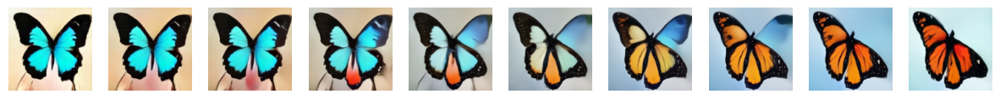

In [ ]:
generated_images = run_interpolation(
    "Image_42.jpg",
    "Image_72.jpg",
    image_size=image_size,
    num_interpolations=num_interpolations,
    t_inv=t_inv
)

show_images(generated_images)

# Question 9: Resnet50 on Animal Dataset

In [ ]:
# Load Data
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder

# Load Data
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

animal_data = ImageFolder('animals', transform=transform)

# Split Data
from torch.utils.data import DataLoader, random_split

train_size = int(0.8 * len(animal_data))
val_size = len(animal_data) - train_size

train_data, val_data = random_split(animal_data, [train_size, val_size])

train_loader = DataLoader(train_data, batch_size=64, shuffle=True)
val_loader = DataLoader(val_data, batch_size=64, shuffle=True)

In [ ]:
num_classes = len(animal_data.classes)

In [ ]:
import torch
from tqdm import tqdm

def train_model(model, criterion, optimizer, PATH, num_epochs=10):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model.to(device)
    running_losses = []
    val_losses = []
    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        for i, data in enumerate(tqdm(train_loader, desc=f"Training Epoch {epoch+1}/{num_epochs}"), 0):
            inputs, labels = data
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
        running_losses.append(running_loss / len(train_loader))
        print(f'Epoch {epoch + 1}, Loss: {running_loss / len(train_loader)}')

        # Evaluate on validation set
        model.eval()
        val_loss = 0.0
        for i, data in enumerate(tqdm(val_loader, desc=f"Validation Epoch {epoch+1}/{num_epochs}"), 0):
            inputs, labels = data
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
        val_losses.append(val_loss / len(val_loader))

        # Save best model
        if epoch == 0:
            best_loss = val_loss
        elif val_loss < best_loss:
            best_loss = val_loss
            torch.save(model.state_dict(), PATH)
        print(f'Validation Loss: {val_loss / len(val_loader)}')
    print('Finished Training')
    return running_losses, val_losses

In [ ]:
def plot_losses(train_losses, val_losses):
    import matplotlib.pyplot as plt
    plt.plot(train_losses, label='Training Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

## Resnet50 with hidden layers frozen

In [ ]:
# Import resnet50 model
import torchvision.models as models
import torch.nn as nn

model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)

for param in model.parameters():
    param.requires_grad = False

model.fc = nn.Sequential(
    nn.Linear(2048, 512),
    nn.ReLU(),
    nn.Dropout(0.2),
    nn.Linear(512, num_classes)
)

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:01<00:00, 79.9MB/s]


In [ ]:
train_losses, val_losses = train_model(model, nn.CrossEntropyLoss(), torch.optim.Adam(model.fc.parameters(), lr=0.001), 'resnet50_hidden_layers_frozen.pth')

Training Epoch 1/10: 100%|██████████| 68/68 [00:53<00:00,  1.27it/s]


Epoch 1, Loss: 2.684146926683538


Validation Epoch 1/10: 100%|██████████| 17/17 [00:12<00:00,  1.37it/s]


Validation Loss: 1.3578785517636467


Training Epoch 2/10: 100%|██████████| 68/68 [00:51<00:00,  1.33it/s]


Epoch 2, Loss: 1.0920218860401827


Validation Epoch 2/10: 100%|██████████| 17/17 [00:11<00:00,  1.42it/s]


Validation Loss: 1.029797497917624


Training Epoch 3/10: 100%|██████████| 68/68 [00:50<00:00,  1.34it/s]


Epoch 3, Loss: 0.8013005133937386


Validation Epoch 3/10: 100%|██████████| 17/17 [00:12<00:00,  1.39it/s]


Validation Loss: 0.9493254843880149


Training Epoch 4/10: 100%|██████████| 68/68 [00:50<00:00,  1.33it/s]


Epoch 4, Loss: 0.6579070130691809


Validation Epoch 4/10: 100%|██████████| 17/17 [00:12<00:00,  1.40it/s]


Validation Loss: 0.8817355667843538


Training Epoch 5/10: 100%|██████████| 68/68 [00:50<00:00,  1.34it/s]


Epoch 5, Loss: 0.5449516606681487


Validation Epoch 5/10: 100%|██████████| 17/17 [00:12<00:00,  1.35it/s]


Validation Loss: 0.8711184999522041


Training Epoch 6/10: 100%|██████████| 68/68 [00:51<00:00,  1.31it/s]


Epoch 6, Loss: 0.46479228423798785


Validation Epoch 6/10: 100%|██████████| 17/17 [00:12<00:00,  1.40it/s]


Validation Loss: 0.8689775659757502


Training Epoch 7/10: 100%|██████████| 68/68 [00:51<00:00,  1.32it/s]


Epoch 7, Loss: 0.40164023440550356


Validation Epoch 7/10: 100%|██████████| 17/17 [00:12<00:00,  1.38it/s]


Validation Loss: 0.8088756238712984


Training Epoch 8/10: 100%|██████████| 68/68 [00:51<00:00,  1.31it/s]


Epoch 8, Loss: 0.359466105042135


Validation Epoch 8/10: 100%|██████████| 17/17 [00:12<00:00,  1.37it/s]


Validation Loss: 0.8097897890736075


Training Epoch 9/10: 100%|██████████| 68/68 [00:52<00:00,  1.30it/s]


Epoch 9, Loss: 0.3152215435881825


Validation Epoch 9/10: 100%|██████████| 17/17 [00:12<00:00,  1.35it/s]


Validation Loss: 0.8473136635387645


Training Epoch 10/10: 100%|██████████| 68/68 [00:52<00:00,  1.30it/s]


Epoch 10, Loss: 0.2840364234631552


Validation Epoch 10/10: 100%|██████████| 17/17 [00:12<00:00,  1.36it/s]

Validation Loss: 0.8294799327850342
Finished Training


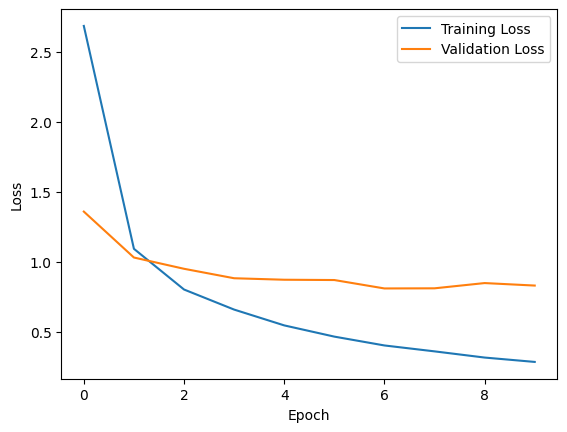

In [ ]:
plot_losses(train_losses, val_losses)

## Resnet50 with all parameters trainable

In [ ]:
# Import resnet50 model
import torchvision.models as models
import torch.nn as nn

model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)

model.fc = nn.Sequential(
    nn.Linear(2048, 512),
    nn.ReLU(),
    nn.Dropout(0.2),
    nn.Linear(512, num_classes)
)

In [ ]:
train_losses, val_losses = train_model(model, nn.CrossEntropyLoss(), torch.optim.Adam(model.fc.parameters(), lr=0.001), 'resnet50_hidden_layers_unfrozen.pth')

Training Epoch 1/10: 100%|██████████| 68/68 [00:59<00:00,  1.15it/s]


Epoch 1, Loss: 2.724892886245952


Validation Epoch 1/10: 100%|██████████| 17/17 [00:12<00:00,  1.36it/s]


Validation Loss: 1.2985413284862743


Training Epoch 2/10: 100%|██████████| 68/68 [01:00<00:00,  1.12it/s]


Epoch 2, Loss: 1.1042090338819168


Validation Epoch 2/10: 100%|██████████| 17/17 [00:12<00:00,  1.34it/s]


Validation Loss: 1.0148199025322409


Training Epoch 3/10: 100%|██████████| 68/68 [01:00<00:00,  1.13it/s]


Epoch 3, Loss: 0.827560214435353


Validation Epoch 3/10: 100%|██████████| 17/17 [00:12<00:00,  1.36it/s]


Validation Loss: 0.9451857770190519


Training Epoch 4/10: 100%|██████████| 68/68 [01:04<00:00,  1.06it/s]


Epoch 4, Loss: 0.64337778617354


Validation Epoch 4/10: 100%|██████████| 17/17 [00:12<00:00,  1.35it/s]


Validation Loss: 0.890907999347238


Training Epoch 5/10: 100%|██████████| 68/68 [01:01<00:00,  1.10it/s]


Epoch 5, Loss: 0.5420774589566624


Validation Epoch 5/10: 100%|██████████| 17/17 [00:12<00:00,  1.35it/s]


Validation Loss: 0.85435691651176


Training Epoch 6/10: 100%|██████████| 68/68 [01:00<00:00,  1.13it/s]


Epoch 6, Loss: 0.4525155663928565


Validation Epoch 6/10: 100%|██████████| 17/17 [00:12<00:00,  1.35it/s]


Validation Loss: 0.8894867651602801


Training Epoch 7/10: 100%|██████████| 68/68 [01:00<00:00,  1.12it/s]


Epoch 7, Loss: 0.3961355648934841


Validation Epoch 7/10: 100%|██████████| 17/17 [00:12<00:00,  1.35it/s]


Validation Loss: 0.8764097164658939


Training Epoch 8/10: 100%|██████████| 68/68 [00:59<00:00,  1.14it/s]


Epoch 8, Loss: 0.35167063706937957


Validation Epoch 8/10: 100%|██████████| 17/17 [00:12<00:00,  1.35it/s]


Validation Loss: 0.8465144809554604


Training Epoch 9/10: 100%|██████████| 68/68 [01:00<00:00,  1.12it/s]


Epoch 9, Loss: 0.31554244721637054


Validation Epoch 9/10: 100%|██████████| 17/17 [00:12<00:00,  1.35it/s]


Validation Loss: 0.8328139045659233


Training Epoch 10/10: 100%|██████████| 68/68 [00:59<00:00,  1.14it/s]


Epoch 10, Loss: 0.2852804635596626


Validation Epoch 10/10: 100%|██████████| 17/17 [00:12<00:00,  1.36it/s]

Validation Loss: 0.8810571607421426
Finished Training


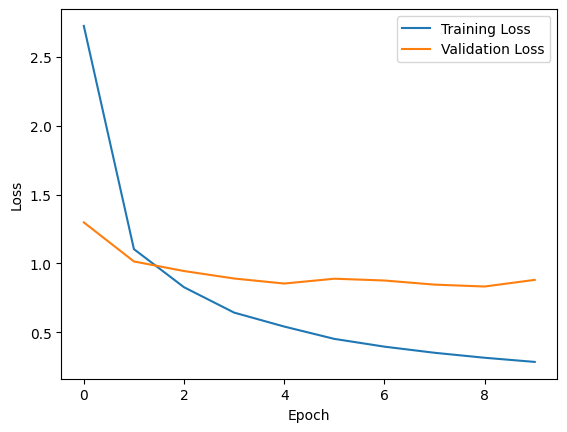

In [ ]:
plot_losses(train_losses, val_losses)

We use the frozen weights model as it performed on less data and less epochs.

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [ ]:
import torch.nn as nn
import torchvision.models as models
model = models.resnet50(weights=None)
model.fc = nn.Sequential(
    nn.Linear(2048, 512),
    nn.ReLU(),
    nn.Dropout(0.2),
    nn.Linear(512, num_classes)
)
model.load_state_dict(torch.load('resnet50_hidden_layers_unfrozen.pth', weights_only=True))

<All keys matched successfully>

In [ ]:
# Report the accuracy of the model on validation set
model.eval()
correct = 0
total = 0
with torch.no_grad():
    for data in val_loader:
        images, labels = data
        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

print(f'Accuracy of the network on the {total} validation images: {100 * correct / total}%')

Accuracy of the network on the 1080 validation images: 91.48148148148148%


# Question 10: Knowledge Distillation

In [ ]:
# Load Data
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder

# Load Data
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

animal_data = ImageFolder('animals', transform=transform)

# Split Data
from torch.utils.data import DataLoader, random_split

train_size = int(0.8 * len(animal_data))
val_size = len(animal_data) - train_size

train_data, val_data = random_split(animal_data, [train_size, val_size])

train_loader = DataLoader(train_data, batch_size=128, shuffle=True)
val_loader = DataLoader(val_data, batch_size=128, shuffle=True)

In [ ]:
num_classes = len(animal_data.classes)

In [ ]:
num_classes

90

In [ ]:
# For knowledge distillatio we will use the following student MLP architecture

import torch
import torch.nn as nn
import torch.nn.functional as F

class MLP(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(MLP, self).__init__()
        self.fc1 = nn.Linear(input_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim)
        self.fc3 = nn.Linear(hidden_dim, output_dim)
        
    def forward(self, x):
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x

# Define the student model
student = MLP(input_dim=128*128*3, hidden_dim=128, output_dim=num_classes)

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [ ]:
# Teacher model

from torchvision import models
teacher = models.resnet50(weights=None)

teacher.fc = nn.Sequential(
    nn.Linear(2048, 512),
    nn.ReLU(),
    nn.Dropout(0.2),
    nn.Linear(512, num_classes)
)

teacher.load_state_dict(torch.load('resnet50_hidden_layers_frozen.pth', map_location=device, weights_only=True))

<All keys matched successfully>

In [ ]:
total_params_deep = "{:,}".format(sum(p.numel() for p in teacher.parameters()))
print(f"Teacher model (resnet50) parameters: {total_params_deep}")
total_params_light = "{:,}".format(sum(p.numel() for p in student.parameters()))
print(f"Student model (MLP) parameters: {total_params_light}")

Teacher model (resnet50) parameters: 24,603,290
Student model (MLP) parameters: 6,319,706


In [ ]:
from tqdm import tqdm

# TRAIN STUDENT MODEL with KL Distillation Loss
def train_knowledge_distillation(student, teacher, train_loader, val_loader, optimizer, criterion, device=device, epochs=10, alpha=0.1, temperature=20):
    student.to(device)
    teacher.to(device)
    student.train()
    teacher.eval()
    train_losses = []
    val_losses = []
    
    for epoch in range(epochs):
        student.train()
        running_loss = 0.0
        for i, (inputs, labels) in enumerate(tqdm(train_loader, desc=f'Epoch {epoch+1}/{epochs}', leave=False)):
            inputs, labels = inputs.to(device), labels.to(device)
            
            optimizer.zero_grad()
            
            student_outputs = student(inputs.view(inputs.size(0), -1)) # Flatten the input for MLP
            with torch.no_grad():
                teacher_outputs = teacher(inputs)
            
            loss = criterion(student_outputs, labels, teacher_outputs, alpha=alpha,temperature=temperature)
            loss.backward()
            optimizer.step()
            
            running_loss += loss.item()
            
            if i % 100 == 99:
                print(f'Epoch: {epoch+1}, Batch: {i+1}, Loss: {running_loss/100}')
                running_loss = 0.0
            
        train_losses.append(running_loss/len(train_loader))
                
        val_loss, val_accuracy = evaluate_knowledge_distillation(student, teacher, val_loader, criterion, device)
        val_losses.append(val_loss)

        print(f'Epoch: {epoch+1}, Validation Loss: {val_loss}, Validation Accuracy: {val_accuracy}')

    return train_losses, val_losses

def evaluate_knowledge_distillation(student, teacher, val_loader, criterion, device=device, alpha=0.1, temperature=20):
    student.eval()
    teacher.eval()
    
    running_loss = 0.0
    best_loss = 0.0
    correct = 0
    total = 0
    
    with torch.no_grad():
        for inputs, labels in tqdm(val_loader, desc='Validation', leave=False):
            inputs, labels = inputs.to(device), labels.to(device)
            
            student_outputs = student(inputs.view(inputs.size(0), -1))
            teacher_outputs = teacher(inputs)
            
            loss = criterion(student_outputs, labels, teacher_outputs, alpha=alpha, temperature=temperature)
            running_loss += loss.item()

            # Save best model
            if running_loss == 0:
                best_loss = running_loss
                torch.save(student.state_dict(), 'best_student_MLP.pth') 
            elif running_loss < best_loss:
                best_loss = running_loss
                torch.save(student.state_dict(), 'best_student_MLP.pth')
            
            _, predicted = torch.max(student_outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
            
    return running_loss/len(val_loader), correct/total

def knowledge_distillation_loss(student_outputs, labels, teacher_outputs, alpha=0.1, temperature=20):
    cross_entropy_loss = F.cross_entropy(student_outputs, labels)

    # KL Distillation loss
    soft_student_prob = F.log_softmax(student_outputs/temperature, dim=1)
    soft_teacher_output = F.softmax(teacher_outputs/temperature, dim=1)
    kl_div_distillation_loss = F.kl_div(soft_student_prob, soft_teacher_output, reduction='batchmean') # Ensures it's scaled by batch size

    return (1-alpha)*cross_entropy_loss + (alpha*kl_div_distillation_loss)*(temperature**2) # Scale by temperature squared because KL div is reduced by temperature

In [ ]:
def plot_losses(train_losses, val_losses):
    import matplotlib.pyplot as plt
    plt.plot(train_losses, label='Training Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

In [ ]:
optimizer = torch.optim.Adam(student.parameters(), lr=0.001)
criterion = knowledge_distillation_loss

train_losses, val_losses = train_knowledge_distillation(student, teacher, train_loader, val_loader, optimizer, criterion, device=device, epochs=15)

Epoch: 1, Validation Loss: 4.491489039527045, Validation Accuracy: 0.024074074074074074


Epoch: 2, Validation Loss: 4.356933010949029, Validation Accuracy: 0.03425925925925926


Epoch: 3, Validation Loss: 4.322123421563043, Validation Accuracy: 0.04351851851851852


Epoch: 4, Validation Loss: 4.294120099809435, Validation Accuracy: 0.044444444444444446


Epoch: 5, Validation Loss: 4.258344915178087, Validation Accuracy: 0.05


Epoch: 6, Validation Loss: 4.266261259714763, Validation Accuracy: 0.06574074074074074


Epoch: 7, Validation Loss: 4.157046185599433, Validation Accuracy: 0.08888888888888889


Epoch: 8, Validation Loss: 4.172937128278944, Validation Accuracy: 0.08518518518518518


Epoch: 9, Validation Loss: 4.1720090177324085, Validation Accuracy: 0.075


Epoch: 10, Validation Loss: 4.119349771075779, Validation Accuracy: 0.08333333333333333


Epoch: 11, Validation Loss: 4.125800371170044, Validation Accuracy: 0.08703703703703704


Epoch: 12, Validation Loss: 4.092879109912449, Validation Accuracy: 0.09166666666666666


Epoch: 13, Validation Loss: 4.081741385989719, Validation Accuracy: 0.09722222222222222


Epoch: 14, Validation Loss: 4.096648083792792, Validation Accuracy: 0.09722222222222222


Epoch: 15, Validation Loss: 4.1372728612687855, Validation Accuracy: 0.09907407407407408


In [ ]:
# Running for more epochs
train_losses, val_losses = train_knowledge_distillation(student, teacher, train_loader, val_loader, optimizer, criterion, device=device, epochs=15)

Epoch: 1, Validation Loss: 4.10582971572876, Validation Accuracy: 0.10092592592592593


Epoch: 2, Validation Loss: 4.126366827223036, Validation Accuracy: 0.09444444444444444


Epoch: 3, Validation Loss: 4.0405680603451195, Validation Accuracy: 0.10833333333333334


Epoch: 4, Validation Loss: 4.1493081251780195, Validation Accuracy: 0.10092592592592593


Epoch: 5, Validation Loss: 4.163152986102634, Validation Accuracy: 0.10925925925925926


Epoch: 6, Validation Loss: 4.094884316126506, Validation Accuracy: 0.12777777777777777


Epoch: 7, Validation Loss: 4.155901352564494, Validation Accuracy: 0.10833333333333334


Epoch: 8, Validation Loss: 4.221529430813259, Validation Accuracy: 0.12314814814814815


Epoch: 9, Validation Loss: 4.203309482998318, Validation Accuracy: 0.11666666666666667


Epoch: 10, Validation Loss: 4.247904724544949, Validation Accuracy: 0.12314814814814815


Epoch: 11, Validation Loss: 4.237291018168132, Validation Accuracy: 0.1259259259259259


Epoch: 12, Validation Loss: 4.226365195380317, Validation Accuracy: 0.12777777777777777


Epoch: 13, Validation Loss: 4.2345009379916725, Validation Accuracy: 0.14444444444444443


Epoch: 14, Validation Loss: 4.212515062756008, Validation Accuracy: 0.15185185185185185


Epoch: 15, Validation Loss: 4.292258792453342, Validation Accuracy: 0.14907407407407408


In [ ]:
torch.save(student.state_dict(), 'student_MLP.pth')

In [ ]:
student.load_state_dict(torch.load('student_MLP.pth', weights_only=True))

<All keys matched successfully>

In [ ]:
# Report the accuracy of the model on validation set
student.to(device)
student.eval()
correct = 0
total = 0
with torch.no_grad():
    for data in val_loader:
        images, labels = data
        images = images.to(device)
        labels = labels.to(device)
        outputs = student(images.view(images.size(0), -1))
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

print(f'Accuracy of the network on the {total} validation images: {100 * correct / total}%')

Accuracy of the network on the 1080 validation images: 14.444444444444445%


We are stuck at best 15% accuracy on the dataset. We have a teacher model that has 90% accuracy on the same dataset. We will change some parameter like alpha and temparture to see if we can improve the accuracy of the student model.

In [ ]:
student = MLP(input_dim=128*128*3, hidden_dim=128, output_dim=num_classes)

optimizer = torch.optim.Adam(student.parameters(), lr=0.001)
criterion = knowledge_distillation_loss

train_losses, val_losses = train_knowledge_distillation(student, teacher, train_loader, val_loader, optimizer, criterion, device=device, epochs=10, alpha=0.5, temperature=5)

Epoch: 1, Validation Loss: 4.416626029544407, Validation Accuracy: 0.018518518518518517


Epoch: 2, Validation Loss: 4.386297225952148, Validation Accuracy: 0.041666666666666664


Epoch: 3, Validation Loss: 4.303076055314806, Validation Accuracy: 0.05648148148148148


Epoch: 4, Validation Loss: 4.254651069641113, Validation Accuracy: 0.05740740740740741


Epoch: 5, Validation Loss: 4.169073899586995, Validation Accuracy: 0.07592592592592592


Epoch: 6, Validation Loss: 4.136344883177015, Validation Accuracy: 0.06481481481481481


Epoch: 7, Validation Loss: 4.121815496020847, Validation Accuracy: 0.09166666666666666


Epoch: 8, Validation Loss: 4.075469758775499, Validation Accuracy: 0.08611111111111111


Epoch: 9, Validation Loss: 4.036671135160658, Validation Accuracy: 0.09814814814814815


Epoch: 10, Validation Loss: 4.010837528440687, Validation Accuracy: 0.09537037037037037


In [ ]:
# Some more epochs
train_losses, val_losses = train_knowledge_distillation(student, teacher, train_loader, val_loader, optimizer, criterion, device=device, epochs=10, alpha=0.5, temperature=5)

Epoch: 1, Validation Loss: 3.988745133082072, Validation Accuracy: 0.1037037037037037


Epoch: 2, Validation Loss: 4.009634812672933, Validation Accuracy: 0.09166666666666666


Epoch: 3, Validation Loss: 3.9894027180141873, Validation Accuracy: 0.11944444444444445


Epoch: 4, Validation Loss: 3.9796538617875843, Validation Accuracy: 0.11388888888888889


Epoch: 5, Validation Loss: 3.9517044756147595, Validation Accuracy: 0.1111111111111111


Epoch: 6, Validation Loss: 3.9466260804070368, Validation Accuracy: 0.11574074074074074


Epoch: 7, Validation Loss: 3.930605994330512, Validation Accuracy: 0.1037037037037037


Epoch: 8, Validation Loss: 3.9121305412716336, Validation Accuracy: 0.11203703703703703


Epoch: 9, Validation Loss: 3.8728488551245794, Validation Accuracy: 0.11944444444444445


Epoch: 10, Validation Loss: 3.951056294971042, Validation Accuracy: 0.12777777777777777


In [ ]:
# Some more epochs
train_losses, val_losses = train_knowledge_distillation(student, teacher, train_loader, val_loader, optimizer, criterion, device=device, epochs=10, alpha=0.5, temperature=5)

Epoch: 1, Validation Loss: 3.9354871114095054, Validation Accuracy: 0.12685185185185185


Epoch: 2, Validation Loss: 3.9178775946299234, Validation Accuracy: 0.12314814814814815


Epoch: 3, Validation Loss: 3.922231912612915, Validation Accuracy: 0.1361111111111111


Epoch: 4, Validation Loss: 3.8920371532440186, Validation Accuracy: 0.13518518518518519


Epoch: 5, Validation Loss: 3.9180220233069525, Validation Accuracy: 0.14722222222222223


Epoch: 6, Validation Loss: 3.9331654177771673, Validation Accuracy: 0.14907407407407408


Epoch: 7, Validation Loss: 3.901448223325941, Validation Accuracy: 0.1527777777777778


Epoch: 8, Validation Loss: 3.918043375015259, Validation Accuracy: 0.14444444444444443


Epoch: 9, Validation Loss: 3.876651313569811, Validation Accuracy: 0.1425925925925926


Epoch: 10, Validation Loss: 3.8978123664855957, Validation Accuracy: 0.1537037037037037


In [ ]:
# Some more epochs
train_losses, val_losses = train_knowledge_distillation(student, teacher, train_loader, val_loader, optimizer, criterion, device=device, epochs=20, alpha=0.7, temperature=3)

Epoch: 1, Validation Loss: 4.164106925328572, Validation Accuracy: 0.16666666666666666


Epoch: 2, Validation Loss: 4.140000449286567, Validation Accuracy: 0.17592592592592593


Epoch: 3, Validation Loss: 4.191231224271986, Validation Accuracy: 0.18055555555555555


Epoch: 4, Validation Loss: 4.30939073032803, Validation Accuracy: 0.17222222222222222


Epoch: 5, Validation Loss: 4.197583940294054, Validation Accuracy: 0.175


Epoch: 6, Validation Loss: 4.213287141587999, Validation Accuracy: 0.17407407407407408


Epoch: 7, Validation Loss: 4.270345369974772, Validation Accuracy: 0.17962962962962964


Epoch: 8, Validation Loss: 4.139416456222534, Validation Accuracy: 0.18333333333333332


Epoch: 9, Validation Loss: 4.2323952251010475, Validation Accuracy: 0.18888888888888888


Epoch: 10, Validation Loss: 4.212633159425524, Validation Accuracy: 0.1685185185185185


Epoch: 11, Validation Loss: 4.187865813573201, Validation Accuracy: 0.17314814814814813


Epoch: 12, Validation Loss: 4.2564299371507435, Validation Accuracy: 0.17592592592592593


Epoch: 13, Validation Loss: 4.304902500576443, Validation Accuracy: 0.1712962962962963


Epoch: 14, Validation Loss: 4.21796629163954, Validation Accuracy: 0.18796296296296297


Epoch: 15, Validation Loss: 4.14638778898451, Validation Accuracy: 0.17314814814814813


Epoch: 16, Validation Loss: 4.0968888600667315, Validation Accuracy: 0.1935185185185185


Epoch: 17, Validation Loss: 4.2449289957682295, Validation Accuracy: 0.1925925925925926


Epoch: 18, Validation Loss: 4.252935303582086, Validation Accuracy: 0.18055555555555555


Epoch: 19, Validation Loss: 4.210001283221775, Validation Accuracy: 0.19166666666666668


Epoch: 20, Validation Loss: 4.305790742238362, Validation Accuracy: 0.1935185185185185


In [ ]:
torch.save(student.state_dict(), 'best_student_model.pth')

In [ ]:
# Report the accuracy of the model on validation set
student.to(device)
student.eval()
correct = 0
total = 0
with torch.no_grad():
    for data in val_loader:
        images, labels = data
        images = images.to(device)
        labels = labels.to(device)
        outputs = student(images.view(images.size(0), -1))
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

print(f'Accuracy of the network on the {total} validation images: {100 * correct / total}%')

Accuracy of the network on the 1080 validation images: 19.72222222222222%


This is the max accuracy we could achieve after around 50 epochs, trying out different values for temperature and alpha and learning rate. 

19.7% accuracy on the test set is a lot more than random guessing = 1.1% accuracy, but still not as good as the teacher model.

Next we try a bit bigger and different student model and see if that helps.

In [ ]:
class StudentModelLarge(nn.Module):
    def __init__(self, input_dim, output_dim):
        super(StudentModelLarge, self).__init__()
        self.fc = nn.Sequential(
            nn.Linear(input_dim, 128),
            nn.ReLU(),
            nn.Linear(128, 512),
            nn.ReLU(),
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.Linear(256, output_dim)
        )

    def forward(self, x):
        x = self.fc(x)
        return x

student_large = StudentModelLarge(input_dim=128*128*3, output_dim=num_classes)

In [ ]:
# Teacher model

from torchvision import models
teacher = models.resnet50(weights=None)

teacher.fc = nn.Sequential(
    nn.Linear(2048, 512),
    nn.ReLU(),
    nn.Dropout(0.2),
    nn.Linear(512, num_classes)
)

teacher.load_state_dict(torch.load('resnet50_hidden_layers_frozen.pth', map_location=device, weights_only=True))

<All keys matched successfully>

In [ ]:
# from pytorch tutorial
total_params_deep = "{:,}".format(sum(p.numel() for p in teacher.parameters()))
print(f"Teacher model (resnet50) parameters: {total_params_deep}")
total_params_light = "{:,}".format(sum(p.numel() for p in student_large.parameters()))
print(f"Student model (MLP) parameters: {total_params_light}")

Teacher model (resnet50) parameters: 24,603,290
Student model (MLP) parameters: 6,512,090


In [ ]:
optimizer = torch.optim.Adam(student_large.parameters(), lr=0.001)
criterion = knowledge_distillation_loss

train_losses, val_losses = train_knowledge_distillation(student_large, teacher, train_loader, val_loader, optimizer, criterion, device=device, epochs=10, alpha=0.5, temperature=3)

Epoch: 1, Validation Loss: 4.2978195614284935, Validation Accuracy: 0.03888888888888889


Epoch: 2, Validation Loss: 4.23236099878947, Validation Accuracy: 0.058333333333333334


Epoch: 3, Validation Loss: 4.157500399483575, Validation Accuracy: 0.0787037037037037


Epoch: 4, Validation Loss: 4.11824287308587, Validation Accuracy: 0.06759259259259259


Epoch: 5, Validation Loss: 4.041989379458958, Validation Accuracy: 0.09444444444444444


Epoch: 6, Validation Loss: 3.9962379932403564, Validation Accuracy: 0.08796296296296297


Epoch: 7, Validation Loss: 4.056472354465061, Validation Accuracy: 0.09166666666666666


Epoch: 8, Validation Loss: 4.0437200334337025, Validation Accuracy: 0.10648148148148148


Epoch: 9, Validation Loss: 4.013674841986762, Validation Accuracy: 0.10555555555555556


Epoch: 10, Validation Loss: 4.074406915240818, Validation Accuracy: 0.11296296296296296


In [ ]:
# increase alpha a little to emphasize on cross entropy loss, and reduce temperature
train_losses, val_losses = train_knowledge_distillation(student_large, teacher, train_loader, val_loader, optimizer, criterion, device=device, epochs=10, alpha=0.6, temperature=2)

Epoch: 1, Validation Loss: 4.134566598468357, Validation Accuracy: 0.11481481481481481


Epoch: 2, Validation Loss: 4.1746775309244795, Validation Accuracy: 0.12777777777777777


Epoch: 3, Validation Loss: 4.156668000751072, Validation Accuracy: 0.13148148148148148


Epoch: 4, Validation Loss: 4.193452146318224, Validation Accuracy: 0.12222222222222222


Epoch: 5, Validation Loss: 4.142087539037068, Validation Accuracy: 0.14166666666666666


Epoch: 6, Validation Loss: 4.270756827460395, Validation Accuracy: 0.13333333333333333


Epoch: 7, Validation Loss: 4.302018774880303, Validation Accuracy: 0.14351851851851852


Epoch: 8, Validation Loss: 4.211752361721462, Validation Accuracy: 0.15185185185185185


Epoch: 9, Validation Loss: 4.303209119372898, Validation Accuracy: 0.17037037037037037


Epoch: 10, Validation Loss: 4.399898317125109, Validation Accuracy: 0.14722222222222223


In [ ]:
# increase learning rate a little
optimizer = torch.optim.Adam(student_large.parameters(), lr=0.0015)
train_losses, val_losses = train_knowledge_distillation(student_large, teacher, train_loader, val_loader, optimizer, criterion, device=device, epochs=10, alpha=0.6, temperature=2)

Epoch: 1, Validation Loss: 4.3909777535332575, Validation Accuracy: 0.16111111111111112


Epoch: 2, Validation Loss: 4.5311509768168134, Validation Accuracy: 0.15925925925925927


Epoch: 3, Validation Loss: 4.441014978620741, Validation Accuracy: 0.1712962962962963


Epoch: 4, Validation Loss: 4.5138845973544655, Validation Accuracy: 0.18611111111111112


Epoch: 5, Validation Loss: 4.52852381600274, Validation Accuracy: 0.19814814814814816


Epoch: 6, Validation Loss: 4.515338526831733, Validation Accuracy: 0.17407407407407408


Epoch: 7, Validation Loss: 4.404590765635173, Validation Accuracy: 0.1925925925925926


Epoch: 8, Validation Loss: 4.548675113254124, Validation Accuracy: 0.2064814814814815


Epoch: 9, Validation Loss: 4.715297381083171, Validation Accuracy: 0.21481481481481482


Epoch: 10, Validation Loss: 4.580897808074951, Validation Accuracy: 0.2111111111111111


In [ ]:
# increase learning rate a little
optimizer = torch.optim.Adam(student_large.parameters(), lr=0.002)
train_losses, val_losses = train_knowledge_distillation(student_large, teacher, train_loader, val_loader, optimizer, criterion, device=device, epochs=10, alpha=0.6, temperature=2)

Epoch: 1, Validation Loss: 4.737471580505371, Validation Accuracy: 0.17222222222222222


Epoch: 2, Validation Loss: 4.918846236334907, Validation Accuracy: 0.2064814814814815


Epoch: 3, Validation Loss: 4.651447772979736, Validation Accuracy: 0.2037037037037037


Epoch: 4, Validation Loss: 4.716360621982151, Validation Accuracy: 0.2212962962962963


Epoch: 5, Validation Loss: 4.654879199133979, Validation Accuracy: 0.19444444444444445


Epoch: 6, Validation Loss: 4.673140313890245, Validation Accuracy: 0.2212962962962963


Epoch: 7, Validation Loss: 4.655681080288357, Validation Accuracy: 0.2101851851851852


Epoch: 8, Validation Loss: 4.854380289713542, Validation Accuracy: 0.21851851851851853


Epoch: 9, Validation Loss: 4.7444700135125055, Validation Accuracy: 0.2064814814814815


Epoch: 10, Validation Loss: 4.735922071668837, Validation Accuracy: 0.23425925925925925


In [ ]:
# increase learning rate a little
optimizer = torch.optim.Adam(student_large.parameters(), lr=0.002)
train_losses, val_losses = train_knowledge_distillation(student_large, teacher, train_loader, val_loader, optimizer, criterion, device=device, epochs=10, alpha=0.7, temperature=3)

Epoch: 1, Validation Loss: 4.391402959823608, Validation Accuracy: 0.2462962962962963


Epoch: 2, Validation Loss: 4.3906486829121905, Validation Accuracy: 0.21851851851851853


Epoch: 3, Validation Loss: 4.310198783874512, Validation Accuracy: 0.24814814814814815


Epoch: 4, Validation Loss: 4.147793743345472, Validation Accuracy: 0.2490740740740741


Epoch: 5, Validation Loss: 4.2563799487219915, Validation Accuracy: 0.2537037037037037


Epoch: 6, Validation Loss: 4.248685386445787, Validation Accuracy: 0.25462962962962965


Epoch: 7, Validation Loss: 4.374030854966906, Validation Accuracy: 0.25277777777777777


Epoch: 8, Validation Loss: 4.152855475743611, Validation Accuracy: 0.2675925925925926


Epoch: 9, Validation Loss: 4.284240934583876, Validation Accuracy: 0.2638888888888889


Epoch: 10, Validation Loss: 4.241329193115234, Validation Accuracy: 0.2611111111111111


In [ ]:
torch.save(student_large.state_dict(), 'best_student_larger_model.pth')

In [ ]:
# Report the accuracy of the model on validation set
student_large.to(device)
student_large.eval()
correct = 0
total = 0
with torch.no_grad():
    for data in val_loader:
        images, labels = data
        images = images.to(device)
        labels = labels.to(device)
        outputs = student_large(images.view(images.size(0), -1))
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

print(f'Accuracy of the network on the {total} validation images: {100 * correct / total}%')

Accuracy of the network on the 1080 validation images: 27.685185185185187%


As we can see, changing the model architecture and adding more layers resulting in a few more parameters helped in increasing accuracy from 19.7 to 27.7% on the test set.

In [ ]:
# Train a student model from scratch to get an idea
import torch
import torch.nn as nn
import torch.optim as optim

mlp_model = StudentModelLarge(input_size=128*128*3, num_classes=num_classes)
optimizer = optim.Adam(mlp_model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()

from tqdm import tqdm
num_epochs = 10
for epoch in range(num_epochs):
    mlp_model.to(device)
    mlp_model.train()
    running_loss = 0.0
    for i, data in enumerate(tqdm(train_loader, desc=f"Training Epoch {epoch+1}/{num_epochs}"), 0):
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = mlp_model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    print(f'Epoch {epoch + 1}, Loss: {running_loss / len(train_loader)}')

    # Evaluate on validation set
    mlp_model.eval()
    val_loss = 0.0
    correct = 0
    total = 0
    for i, data in enumerate(tqdm(val_loader, desc=f"Validation Epoch {epoch+1}/{num_epochs}"), 0):
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = mlp_model(inputs)
        loss = criterion(outputs, labels)
        val_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    print(f'Validation Loss: {val_loss / len(val_loader)}')
    print(f'Validation Accuracy: {100 * correct / total}%')

Training Epoch 1/10: 100%|██████████| 34/34 [00:31<00:00,  1.07it/s]


Epoch 1, Loss: 7.21093311029322


Validation Epoch 1/10: 100%|██████████| 9/9 [00:07<00:00,  1.14it/s]


Validation Loss: 4.477380858527289
Validation Accuracy: 2.7777777777777777%


Training Epoch 2/10: 100%|██████████| 34/34 [00:29<00:00,  1.16it/s]


Epoch 2, Loss: 4.440294504165649


Validation Epoch 2/10: 100%|██████████| 9/9 [00:07<00:00,  1.25it/s]


Validation Loss: 4.469326496124268
Validation Accuracy: 2.2222222222222223%


Training Epoch 3/10: 100%|██████████| 34/34 [00:31<00:00,  1.09it/s]


Epoch 3, Loss: 4.386940254884608


Validation Epoch 3/10: 100%|██████████| 9/9 [00:07<00:00,  1.15it/s]


Validation Loss: 4.421241760253906
Validation Accuracy: 2.685185185185185%


Training Epoch 4/10: 100%|██████████| 34/34 [00:31<00:00,  1.08it/s]


Epoch 4, Loss: 4.318444350186517


Validation Epoch 4/10: 100%|██████████| 9/9 [00:07<00:00,  1.15it/s]


Validation Loss: 4.436488840315077
Validation Accuracy: 2.7777777777777777%


Training Epoch 5/10: 100%|██████████| 34/34 [00:30<00:00,  1.10it/s]


Epoch 5, Loss: 4.254158637102912


Validation Epoch 5/10: 100%|██████████| 9/9 [00:07<00:00,  1.13it/s]


Validation Loss: 4.412372907002767
Validation Accuracy: 2.962962962962963%


Training Epoch 6/10: 100%|██████████| 34/34 [00:31<00:00,  1.08it/s]


Epoch 6, Loss: 4.203707063899321


Validation Epoch 6/10: 100%|██████████| 9/9 [00:08<00:00,  1.11it/s]


Validation Loss: 4.381499131520589
Validation Accuracy: 3.7037037037037037%


Training Epoch 7/10: 100%|██████████| 34/34 [00:31<00:00,  1.08it/s]


Epoch 7, Loss: 4.1552252769470215


Validation Epoch 7/10: 100%|██████████| 9/9 [00:07<00:00,  1.13it/s]


Validation Loss: 4.357109599643284
Validation Accuracy: 4.907407407407407%


Training Epoch 8/10: 100%|██████████| 34/34 [00:31<00:00,  1.07it/s]


Epoch 8, Loss: 4.066223298802095


Validation Epoch 8/10: 100%|██████████| 9/9 [00:07<00:00,  1.16it/s]


Validation Loss: 4.351820945739746
Validation Accuracy: 5.185185185185185%


Training Epoch 9/10: 100%|██████████| 34/34 [00:31<00:00,  1.09it/s]


Epoch 9, Loss: 4.002632505753461


Validation Epoch 9/10: 100%|██████████| 9/9 [00:08<00:00,  1.11it/s]


Validation Loss: 4.365952173868815
Validation Accuracy: 5.277777777777778%


Training Epoch 10/10: 100%|██████████| 34/34 [00:31<00:00,  1.06it/s]


Epoch 10, Loss: 3.9284025641048657


Validation Epoch 10/10: 100%|██████████| 9/9 [00:07<00:00,  1.15it/s]

Validation Loss: 4.302895492977566
Validation Accuracy: 6.296296296296297%


In [ ]:
# Report the accuracy of the model on validation set
mlp_model.to(device)
mlp_model.eval()
correct = 0
total = 0
with torch.no_grad():
    for data in val_loader:
        images, labels = data
        images = images.to(device)
        labels = labels.to(device)
        outputs = mlp_model(images.view(images.size(0), -1))
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

print(f'Accuracy of the network on the {total} validation images: {100 * correct / total}%')

Accuracy of the network on the 1080 validation images: 6.111111111111111%


For reference, this is what a normal MLP model accuracy is. Compared to that, we get a lot better results with knowledge distillation.

In [ ]:
## Adapted the codebase from https://github.com/gaasher/I-JEPA

In [ ]:
import torch
import torch.nn as nn
import math
import torch.nn.functional as F
from einops import rearrange, repeat
from x_transformers import Encoder, Decoder
import copy

'''
PatchEmbed class, adapted from https://towardsdatascience.com/implementing-visualttransformer-in-pytorch-184f9f16f632 I think, but I dont have medium premium so idk
- This class is used to convert the image into patches using a convolutional layer
'''
class PatchEmbed(nn.Module):
    """Image to Patch Embedding"""

    def __init__(self, img_size=224, patch_size=16, in_chans=3, embed_dim=64):
        super().__init__()
        if isinstance(img_size, int):
            img_size = img_size, img_size
        if isinstance(patch_size, int):
            patch_size = patch_size, patch_size
        #calculate the number of patches
        self.patch_shape = (img_size[0] // patch_size[0], img_size[1] // patch_size[1])

        #convolutional layer to convert the image into patches
        self.conv = nn.Conv2d(
            in_chans, embed_dim, kernel_size=patch_size, stride=patch_size
        )
        

    def forward(self, x):
        x = self.conv(x)
        #flatten the patches
        x = rearrange(x, 'b e h w -> b (h w) e')
        return x

'''Lightweight Predictor Module using VIT to predict target patches from context patches'''
class Predictor(nn.Module):
    def __init__(self, embed_dim, num_heads, depth):
        super().__init__()
        
        self.predictor = Decoder(dim = embed_dim, depth = depth, heads = num_heads)
    def forward(self, context_encoding, target_masks):
        x = torch.cat((context_encoding, target_masks), dim = 1)
        x = self.predictor(x)
        #return last len(target_masks) tokens
        l = x.shape[1]
        return x[:, l - target_masks.shape[1]:, :]
    
'''Main Model Class'''
class IJEPA_base(nn.Module):
    def __init__(self, img_size, patch_size, in_chans, embed_dim, enc_depth, pred_depth, num_heads, post_emb_norm=False, M = 4, mode="train", layer_dropout=0.):
        super().__init__()
        self.M = M
        self.mode = mode
        self.layer_dropout = layer_dropout

        #define the patch embedding and positional embedding
        self.patch_embed = PatchEmbed(img_size=img_size, patch_size=patch_size, in_chans=in_chans, embed_dim=embed_dim)
        self.patch_dim  = (self.patch_embed.patch_shape[0], self.patch_embed.patch_shape[1])
        self.num_tokens = self.patch_embed.patch_shape[0] * self.patch_embed.patch_shape[1]
        self.pos_embedding = nn.Parameter(torch.randn(1, self.num_tokens, embed_dim))

        #define the cls and mask tokens
        self.mask_token = nn.Parameter(torch.randn(1, 1, embed_dim))
        nn.init.trunc_normal_(self.mask_token, 0.02)

        #define the encoder and decoder, as well as the layer normalization and dropout
        self.post_emb_norm = nn.LayerNorm(embed_dim) if post_emb_norm else nn.Identity()
        self.norm = nn.LayerNorm(embed_dim)
        self.teacher_encoder = Encoder(
            dim=embed_dim,
            heads=num_heads,
            depth=enc_depth, 
            layer_dropout=self.layer_dropout,
        )  
        self.student_encoder = copy.deepcopy(self.teacher_encoder).cuda()
        self.predictor = Predictor(embed_dim, num_heads, pred_depth)

    @torch.no_grad() 
    def get_target_block(self, target_encoder, x, patch_dim, aspect_ratio, scale, M):  
        #get the target block
        target_encoder = target_encoder.eval()
        x = target_encoder(x)
        x = self.norm(x)
        #get the patch dimensions
        patch_h, patch_w = patch_dim
        #get the number of patches
        num_patches = patch_h * patch_w
        #get the number of patches in the target block
        num_patches_block = int(patch_h * patch_w * scale)
        #get the height and width of the target block with aspect ratio
        block_h = int(torch.sqrt(torch.tensor(num_patches_block / aspect_ratio)))
        block_w = int(aspect_ratio * block_h)
        #get the patches in the target block
        target_block = torch.zeros((M, x.shape[0], block_h*block_w, x.shape[2]))
        target_patches = []
        all_patches = []
        for z in range(M):
            #get the starting patch
            start_patch_h = torch.randint(0, patch_h - block_h+1, (1,)).item()
            start_patch_w = torch.randint(0, patch_w - block_w+1, (1,)).item()
            start_patch = start_patch_h * patch_w + start_patch_w

            patches = []
            #get the patches in the target block
            for i in range(block_h):
                for j in range(block_w):
                    patches.append(start_patch + i * patch_w + j)
                    if start_patch + i * patch_w + j not in all_patches:
                        all_patches.append(start_patch + i * patch_w + j)
                    
            #get the target block
            target_patches.append(patches)
            target_block[z] = x[:, patches, :]
        return target_block.cuda(), target_patches, all_patches

    def get_context_block(self, x, patch_dim, aspect_ratio, scale, target_patches):
        patch_h, patch_w = patch_dim
        #get the number of patches in the target block
        num_patches_block = int(patch_h * patch_w * scale)
        #get the height and width of the target block with aspect ratio
        block_h = int(torch.sqrt(torch.tensor(num_patches_block / aspect_ratio)))
        block_w = int(aspect_ratio * block_h)
        #get the starting patch
        start_patch_h = torch.randint(0, patch_h - block_h+1, (1,)).item()
        start_patch_w = torch.randint(0, patch_w - block_w+1, (1,)).item()
        start_patch = start_patch_h * patch_w + start_patch_w
        #get the patches in the context_block
        patches = []
        for i in range(block_h):
            for j in range(block_w):
                if start_patch + i * patch_w + j not in target_patches: #remove the target patches
                    patches.append(start_patch + i * patch_w + j)
        return x[:, patches, :]


    def forward(self, x, target_aspect_ratio=1, target_scale=1, context_aspect_ratio=1, context_scale=1):
        #get the patch embeddings
        if isinstance(x, tuple) or isinstance(x, list):
            x = x[0]
        x = self.patch_embed(x)
        b, n, e = x.shape
        #add the positional embeddings
        x = x + self.pos_embedding
        #normalize the embeddings
        x = self.post_emb_norm(x)
        #if mode is test, we get return full embedding:
        if self.mode == 'test':
            return self.student_encoder(x)
        # #get target embeddings
        target_blocks, target_patches, all_patches = self.get_target_block(self.teacher_encoder, x, self.patch_dim, target_aspect_ratio, target_scale, self.M)
        m, b, n, e = target_blocks.shape
        #get context embedding

        context_block = self.get_context_block(x, self.patch_dim, context_aspect_ratio, context_scale, all_patches)
        context_encoding = self.student_encoder(context_block)
        context_encoding = self.norm(context_encoding)


        prediction_blocks = torch.zeros((m, b, n, e)).cuda()
        #get the prediction blocks, predict each target block separately
        for i in range(m):
            target_masks = self.mask_token.repeat(b, n, 1)
            target_pos_embedding = self.pos_embedding[:, target_patches[i], :]
            target_masks = target_masks + target_pos_embedding
            prediction_blocks[i] = self.predictor(context_encoding, target_masks)

        return prediction_blocks, target_blocks

In [ ]:
import numpy as np
import pytorch_lightning as pl
import torch.nn as nn
import torch
from torch.utils.data import Dataset
from torch.utils.data import DataLoader, random_split
from torchvision.datasets import ImageFolder
from torchvision import transforms
from pytorch_lightning.callbacks import (
    ModelCheckpoint,
    LearningRateMonitor,
    ModelSummary,
)
from pytorch_lightning.loggers import WandbLogger


'''Dummy Dataset'''
class IJEPADataset(Dataset):
    def __init__(self,
                 dataset_path,
                 stage='train',
                 ):
        super().__init__()
        img1 =torch.randn(3, 224, 224)
        self.data = img1.repeat(100, 1, 1, 1)
        
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, index):
        return self.data[index]


'''Placeholder for datamodule in pytorch lightning'''
'''
Placeholder for datamodule in pytorch lightning
'''
class D2VDataModule(pl.LightningDataModule):
    def __init__(self,
                 dataset_path,
                 batch_size=64,
                 num_workers=4,
                 pin_memory=True,
                 shuffle=True
                 ):
        super().__init__()
        
        self.dataset_path = dataset_path
        self.batch_size = batch_size
        self.num_workers = num_workers
        self.shuffle = shuffle
        
    def setup(self, stage=None):
        transform = transforms.Compose([
            transforms.Resize((224, 224)),
            transforms.RandomHorizontalFlip(),
            transforms.RandomVerticalFlip(),
            transforms.RandomRotation(10),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
        ])

        data = ImageFolder(self.dataset_path, transform=transform)

        train_size = int(0.8 * len(data))
        val_size = len(data) - train_size

        train_data, val_data = random_split(data, [train_size, val_size])

        self.train_dataset = train_data
        self.val_dataset = val_data

    def train_dataloader(self):
        return DataLoader(
            self.train_dataset,
            batch_size=self.batch_size,
            num_workers=self.num_workers,
            shuffle=self.shuffle,
        )
    
    def val_dataloader(self):
        return DataLoader(
            self.val_dataset,
            batch_size=self.batch_size,
            num_workers=self.num_workers,
            shuffle=False,
        )

'''
pytorch lightning model
'''
class IJEPA(pl.LightningModule):
    def __init__(
            self,
            img_size=224,
            patch_size=16,
            in_chans=3, 
            embed_dim=64,
            enc_heads=8,
            enc_depth=8,
            decoder_depth=6,
            lr=1e-6,
            weight_decay=0.05,
            target_aspect_ratio = (0.75,1.5),
            target_scale = (0.15, .2),
            context_aspect_ratio = 1,
            context_scale = (0.85,1.0),
            M = 4, #number of different target blocks
            m=0.996, #momentum
            m_start_end = (.996, 1.)

    ):
        super().__init__()
        self.save_hyperparameters()
        
        #define models
        self.model = IJEPA_base(img_size=img_size, patch_size=patch_size, in_chans=in_chans, embed_dim=embed_dim, 
                                enc_depth = enc_depth, num_heads=enc_heads, pred_depth=decoder_depth, M=M)

        #define hyperparameters
        self.M = M
        self.lr = lr
        self.weight_decay = weight_decay
        self.m = m
        self.target_aspect_ratio = target_aspect_ratio
        self.target_scale = target_scale
        self.context_aspect_ratio = context_aspect_ratio
        self.context_scale = context_scale
        self.embed_dim = embed_dim
        self.patch_size = patch_size
        self.num_tokens = (img_size // patch_size) ** 2
        self.m_start_end = m_start_end

        #define loss
        self.criterion = nn.MSELoss()
    
    def forward(self, x, target_aspect_ratio, target_scale, context_aspect_ratio, context_scale):
        return self.model(x, target_aspect_ratio, target_scale, context_aspect_ratio, context_scale)
    
    '''Update momentum for teacher encoder'''
    def update_momentum(self, m):
        student_model = self.model.student_encoder.eval()
        teacher_model = self.model.teacher_encoder.eval()
        with torch.no_grad():
            for student_param, teacher_param in zip(student_model.parameters(), teacher_model.parameters()):
                teacher_param.data.mul_(other=m).add_(other=student_param.data, alpha=1 - m)


    def training_step(self, batch, batch_idx):
        x = batch
        #generate random target and context aspect ratio and scale
        target_aspect_ratio = np.random.uniform(self.target_aspect_ratio[0], self.target_aspect_ratio[1])
        target_scale = np.random.uniform(self.target_scale[0], self.target_scale[1])
        context_aspect_ratio = self.context_aspect_ratio
        context_scale = np.random.uniform(self.context_scale[0], self.context_scale[1])

        y_student, y_teacher = self(x, target_aspect_ratio, target_scale, context_aspect_ratio, context_scale)
        loss = self.criterion(y_student, y_teacher)
        self.log('train_loss', loss)
                    
        return loss
    
    def validation_step(self, batch, batch_idx):
        x = batch
        target_aspect_ratio = np.random.uniform(self.target_aspect_ratio[0], self.target_aspect_ratio[1])
        target_scale = np.random.uniform(self.target_scale[0], self.target_scale[1])
        context_aspect_ratio = self.context_aspect_ratio
        context_scale = np.random.uniform(self.context_scale[0], self.context_scale[1])

        y_student, y_teacher = self(x, target_aspect_ratio, target_scale, context_aspect_ratio, context_scale)
        loss = self.criterion(y_student, y_teacher)
        self.log('val_loss', loss)
        
        return loss
    
    def predict_step(self, batch, batch_idx, dataloader_idx):
        target_aspect_ratio = np.random.uniform(self.target_aspect_ratio[0], self.target_aspect_ratio[1])
        target_scale = np.random.uniform(self.target_scale[0], self.target_scale[1])
        context_aspect_ratio = self.context_aspect_ratio
        context_scale = 1
        self.model.mode = "test"

        return self(batch, target_aspect_ratio, target_scale, context_aspect_ratio, context_scale) #just get teacher embedding

    def on_after_backward(self):
        self.update_momentum(self.m)
        self.m += (self.m_start_end[1] - self.m_start_end[0]) / self.trainer.estimated_stepping_batches


    def configure_optimizers(self):
        optimizer = torch.optim.AdamW(self.parameters(), lr=self.lr, weight_decay=self.weight_decay)
        scheduler = torch.optim.lr_scheduler.OneCycleLR(
            optimizer,
            max_lr=self.lr,
            total_steps=self.trainer.estimated_stepping_batches,
        )
        return {
            "optimizer": optimizer,
            "lr_scheduler": {
                "scheduler": scheduler,
                "interval": "step",
            },
        }

In [ ]:
dataset = D2VDataModule(dataset_path='animals')

model = IJEPA(img_size=224, patch_size=16, in_chans=3, embed_dim=64, enc_heads=8, enc_depth=8, decoder_depth=6, lr=1e-3)

lr_monitor = LearningRateMonitor(logging_interval="step")
model_summary = ModelSummary(max_depth=2)

trainer = pl.Trainer(
    accelerator='gpu',
    devices=1,
    precision=16,
    max_epochs=10,
    callbacks=[lr_monitor, model_summary],
    gradient_clip_val=.1,
)

trainer.fit(model, dataset)

Using 16bit Automatic Mixed Precision (AMP)
Trainer already configured with model summary callbacks: [<class 'pytorch_lightning.callbacks.model_summary.ModelSummary'>]. Skipping setting a default `ModelSummary` callback.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
Loading `train_dataloader` to estimate number of stepping batches.

  | Name                  | Type       | Params | Mode 
-------------------------------------------------------------
0 | model                 | IJEPA_base | 3.7 M  | train
1 | model.patch_embed     | PatchEmbed | 49.2 K | train
2 | model.post_emb_norm   | Identity   | 0      | train
3 | model.norm            | LayerNorm  | 128    | train
4 | model.teacher_encoder | Encoder    | 1.3 M  | train
5 | model.student_encoder | Encoder    | 1.3 M  | train
6 | model.predictor       | Predictor  | 985 K  | train
7 | criterion             | MSELoss    | 

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


In [ ]:
torch.save(model.state_dict(), 'git-jepa.pth')

In [ ]:
# Load Data
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder

# Load Data
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

animal_data = ImageFolder('animals', transform=transform)

# Split Data
from torch.utils.data import DataLoader, random_split

train_size = int(0.8 * len(animal_data))
val_size = len(animal_data) - train_size

train_data, val_data = random_split(animal_data, [train_size, val_size])

train_loader = DataLoader(train_data, batch_size=128, shuffle=True)
val_loader = DataLoader(val_data, batch_size=128, shuffle=True)

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [ ]:
model = IJEPA(img_size=224, patch_size=16, in_chans=3, embed_dim=64, enc_heads=8, enc_depth=8, decoder_depth=6, lr=1e-3)
model.load_state_dict(torch.load('git-jepa.pth', weights_only=True))

<All keys matched successfully>

In [ ]:
# Test the IJEPA model accuracy on the validation set
model.eval()
model.to(device)

with torch.no_grad():
    for batch in val_loader:
        x = batch[0].to(device)
        target_aspect_ratio = np.random.uniform(model.target_aspect_ratio[0], model.target_aspect_ratio[1])
        target_scale = np.random.uniform(model.target_scale[0], model.target_scale[1])
        context_aspect_ratio = model.context_aspect_ratio
        context_scale = 1
        y_student, y_teacher = model(x, target_aspect_ratio, target_scale, context_aspect_ratio, context_scale)
        accuracy = torch.mean((y_student.argmax(dim=-1) == y_teacher.argmax(dim=-1)).float())
        print(f'Accuracy: {accuracy.item() * 100:.2f}%')
        break

Accuracy: 38.31%
